In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import time
import random
from rich.console import Console
from rich.text import Text

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/LICENSE.md
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/model_index.json
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/pipeline.png
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/README.md
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/sd_xl_base_1.0.safetensors
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/sd_xl_offset_example-lora_1.0.safetensors
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/01.png
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/comparison.png
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/sd_xl_base_1.0_0.9vae.safetensors
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/.gitattributes
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/tokenizer_2/merges.txt
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/tokenizer_2/vocab.json
/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1/tokenizer_2/tokenizer_config.json
/kaggle/input/stable-diffusion-xl/pytorc

# Start importing the libraries

In [2]:
!pip install diffusers transformers accelerate scipy safetensors

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 12.0 MB/s eta 0:00:00


In [3]:
from diffusers import DiffusionPipeline, EulerDiscreteScheduler
import torch
import matplotlib.pyplot as plt
pipe = DiffusionPipeline.from_pretrained("/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1", torch_dtype=torch.float16, use_safetensors=True, variant="fp16")
pipe.to("cuda")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.30.2",
  "_name_or_path": "/kaggle/input/stable-diffusion-xl/pytorch/base-1-0/1",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

# Define Prompt Function

In [4]:
def generate_stable_diffusion_image(prompt):
    return pipe(prompt=prompt).images[0]

# Try a few prompts in a loop

In [5]:
!pip install rich

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


A breathtaking sunrise over the majestic Himalayas, where the first rays of sunlight illuminate the snow-capped peaks. Below, a lush valley shrouded in mist reveals terraced fields and small villages, with colorful prayer flags fluttering in the gentle breeze, symbolizing peace and spirituality.


A breathtaking sunrise over the majestic Himalayas, where the first rays of sunlight illuminate the snow-capped 
peaks. Below, a lush valley shrouded in mist reveals terraced fields and small villages, with colorful prayer flags
fluttering in the gentle breeze, symbolizing peace and spirituality.

  0%|          | 0/50 [00:00<?, ?it/s]

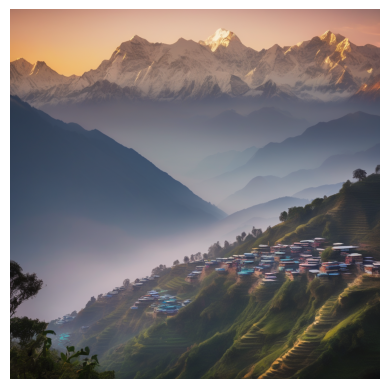

An enchanting underwater scene in the Great Barrier Reef, showcasing a vibrant coral ecosystem. Schools of tropical fish in brilliant hues swim among the corals, while a graceful sea turtle glides effortlessly through the crystal-clear water. Sunlight filters down from the surface, creating a magical atmosphere filled with life.


An enchanting underwater scene in the Great Barrier Reef, showcasing a vibrant coral ecosystem. Schools of tropical
fish in brilliant hues swim among the corals, while a graceful sea turtle glides effortlessly through the 
crystal-clear water. Sunlight filters down from the surface, creating a magical atmosphere filled with life.

  0%|          | 0/50 [00:00<?, ?it/s]

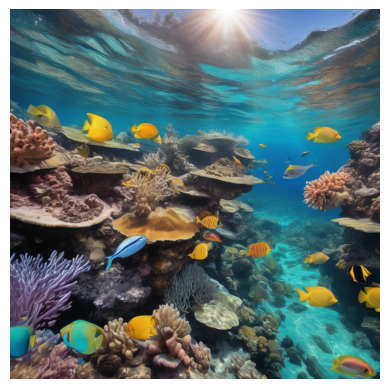

A dense and thriving rainforest, where towering trees with thick canopies create a natural cathedral. Exotic birds with vivid plumage flit between branches, while colorful orchids and ferns blanket the forest floor. A serene waterfall cascades into a tranquil pool, surrounded by lush greenery and the sounds of nature.


A dense and thriving rainforest, where towering trees with thick canopies create a natural cathedral. Exotic birds 
with vivid plumage flit between branches, while colorful orchids and ferns blanket the forest floor. A serene 
waterfall cascades into a tranquil pool, surrounded by lush greenery and the sounds of nature.

  0%|          | 0/50 [00:00<?, ?it/s]

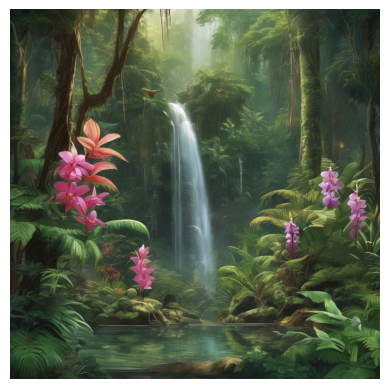

A futuristic cityscape at night, where sleek skyscrapers adorned with holographic advertisements rise against a starry sky. Flying cars zip through the air, leaving trails of light, while pedestrians walk along illuminated walkways. The city is a blend of nature and technology, with vertical gardens integrated into the architecture.


A futuristic cityscape at night, where sleek skyscrapers adorned with holographic advertisements rise against a 
starry sky. Flying cars zip through the air, leaving trails of light, while pedestrians walk along illuminated 
walkways. The city is a blend of nature and technology, with vertical gardens integrated into the architecture.

  0%|          | 0/50 [00:00<?, ?it/s]

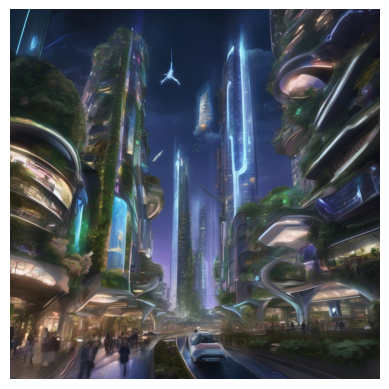

An astronaut floating in the vastness of space, with Earth visible in the background, a vibrant blue and green marble against the black void. Stars twinkle in the distance, and a nearby satellite orbits silently. The astronaut's suit reflects the sunlight, creating a stunning contrast against the infinite cosmos.


An astronaut floating in the vastness of space, with Earth visible in the background, a vibrant blue and green 
marble against the black void. Stars twinkle in the distance, and a nearby satellite orbits silently. The 
astronaut's suit reflects the sunlight, creating a stunning contrast against the infinite cosmos.

  0%|          | 0/50 [00:00<?, ?it/s]

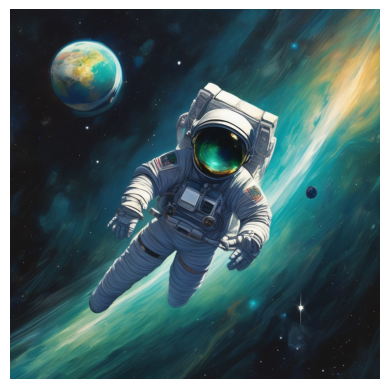

A close-up view of a high-tech computer circuit board, filled with intricate designs and glowing components. The board is alive with activity, showcasing data transmission through light pulses. This visual representation of technology highlights the complexity and beauty of modern electronics.


A close-up view of a high-tech computer circuit board, filled with intricate designs and glowing components. The 
board is alive with activity, showcasing data transmission through light pulses. This visual representation of 
technology highlights the complexity and beauty of modern electronics.

  0%|          | 0/50 [00:00<?, ?it/s]

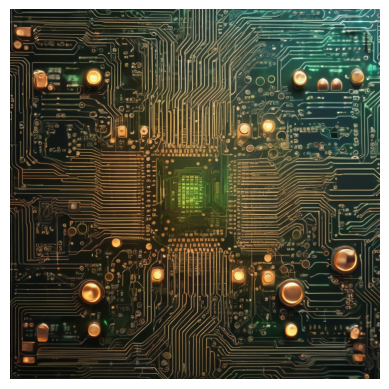

A diverse group of people from various cultures gathered at a bustling street market, sharing a meal together. Colorful stalls display an array of dishes from around the world, with spices and aromas filling the air. Laughter and conversation blend as they enjoy traditional foods, celebrating unity in diversity.


A diverse group of people from various cultures gathered at a bustling street market, sharing a meal together. 
Colorful stalls display an array of dishes from around the world, with spices and aromas filling the air. Laughter 
and conversation blend as they enjoy traditional foods, celebrating unity in diversity.

  0%|          | 0/50 [00:00<?, ?it/s]

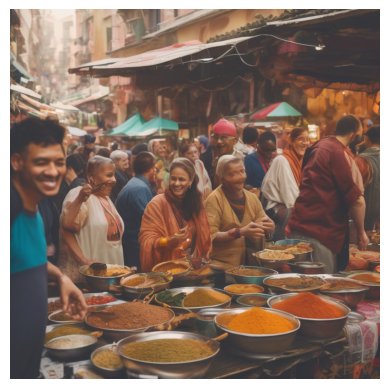

An artist passionately painting a large mural on a city wall, capturing the essence of urban life and cultural diversity. The mural features vibrant colors and intricate designs, depicting scenes of community, history, and hope. Bystanders watch in awe, inspired by the creativity and expression of the artist.


An artist passionately painting a large mural on a city wall, capturing the essence of urban life and cultural 
diversity. The mural features vibrant colors and intricate designs, depicting scenes of community, history, and 
hope. Bystanders watch in awe, inspired by the creativity and expression of the artist.

  0%|          | 0/50 [00:00<?, ?it/s]

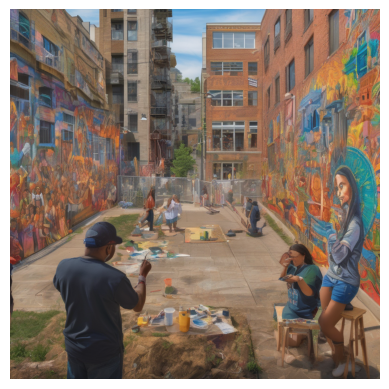

A tranquil scene in a Japanese Zen garden, where a person practices mindfulness meditation. Surrounded by meticulously raked gravel, carefully placed rocks, and blooming cherry blossom trees, the individual finds peace and serenity. Soft petals fall gently around them, enhancing the atmosphere of calm.


A tranquil scene in a Japanese Zen garden, where a person practices mindfulness meditation. Surrounded by 
meticulously raked gravel, carefully placed rocks, and blooming cherry blossom trees, the individual finds peace 
and serenity. Soft petals fall gently around them, enhancing the atmosphere of calm.

  0%|          | 0/50 [00:00<?, ?it/s]

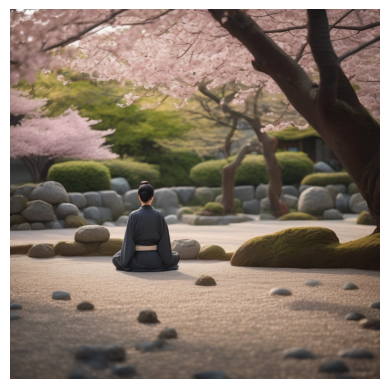

A majestic lion resting on a sunlit rock in the African savannah, its golden mane glistening in the warm light. The vast landscape stretches out behind it, dotted with acacia trees and distant mountains. This powerful creature embodies strength and grace, a true king of the wild.


A majestic lion resting on a sunlit rock in the African savannah, its golden mane glistening in the warm light. The
vast landscape stretches out behind it, dotted with acacia trees and distant mountains. This powerful creature 
embodies strength and grace, a true king of the wild.

  0%|          | 0/50 [00:00<?, ?it/s]

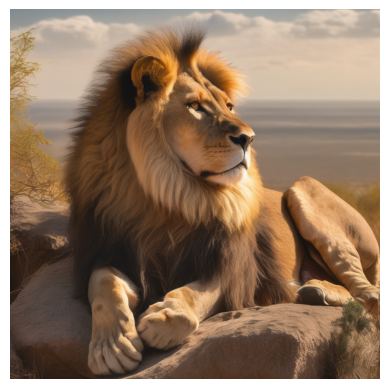

A playful dolphin leaping out of the ocean waves during a stunning sunset. The sky is painted in shades of orange, pink, and purple, reflecting on the water's surface. The dolphin's sleek body arcs gracefully through the air, capturing the joy and freedom of life in the sea.


A playful dolphin leaping out of the ocean waves during a stunning sunset. The sky is painted in shades of orange, 
pink, and purple, reflecting on the water's surface. The dolphin's sleek body arcs gracefully through the air, 
capturing the joy and freedom of life in the sea.

  0%|          | 0/50 [00:00<?, ?it/s]

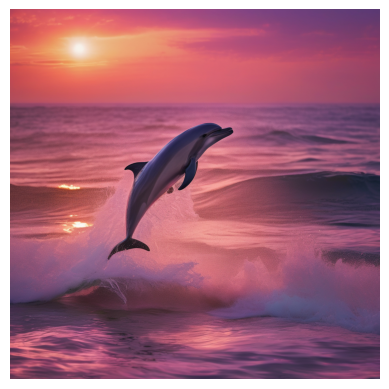

A close-up of a colorful butterfly perched delicately on a vibrant flower in a blooming garden. The intricate patterns on its wings are illuminated by sunlight, showcasing nature's artistry. Nearby, other insects buzz around, contributing to the lively atmosphere of the garden.


A close-up of a colorful butterfly perched delicately on a vibrant flower in a blooming garden. The intricate 
patterns on its wings are illuminated by sunlight, showcasing nature's artistry. Nearby, other insects buzz around,
contributing to the lively atmosphere of the garden.

  0%|          | 0/50 [00:00<?, ?it/s]

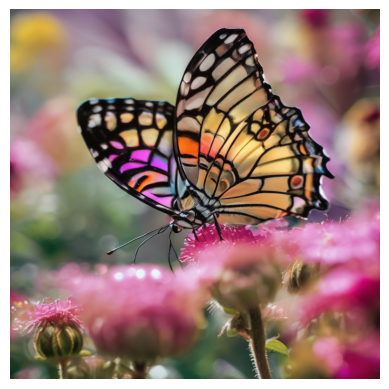

A vast field of wildflowers in full bloom, showcasing a riot of colors—reds, yellows, blues, and purples. Bees and butterflies flit from flower to flower, pollinating as they go. In the distance, rolling hills provide a picturesque backdrop, creating a scene of natural beauty and harmony.


A vast field of wildflowers in full bloom, showcasing a riot of colors—reds, yellows, blues, and purples. Bees and 
butterflies flit from flower to flower, pollinating as they go. In the distance, rolling hills provide a 
picturesque backdrop, creating a scene of natural beauty and harmony.

  0%|          | 0/50 [00:00<?, ?it/s]

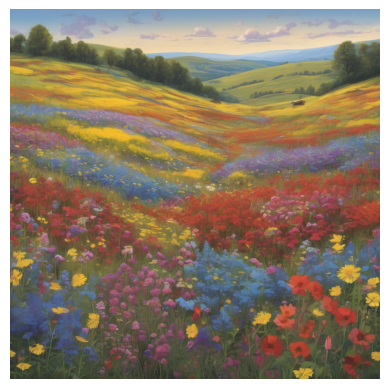

A tranquil rice terrace in Bali, where lush green fields cascade down the hillside in a series of steps. Farmers work diligently, planting and harvesting rice, while the sun sets behind the mountains, casting a golden glow over the landscape. This image captures the beauty of agriculture and tradition.


A tranquil rice terrace in Bali, where lush green fields cascade down the hillside in a series of steps. Farmers 
work diligently, planting and harvesting rice, while the sun sets behind the mountains, casting a golden glow over 
the landscape. This image captures the beauty of agriculture and tradition.

  0%|          | 0/50 [00:00<?, ?it/s]

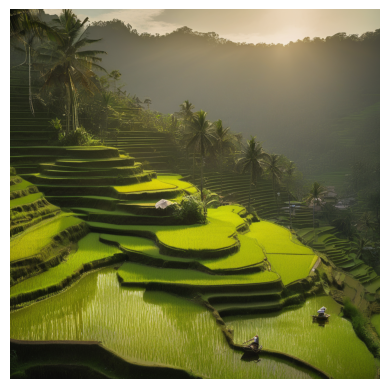

A stunning desert landscape featuring towering saguaro cacti under a starry night sky. The Milky Way stretches across the heavens, illuminating the desert floor with a soft glow. The cacti stand tall and proud, symbolizing resilience in the harsh environment.


A stunning desert landscape featuring towering saguaro cacti under a starry night sky. The Milky Way stretches 
across the heavens, illuminating the desert floor with a soft glow. The cacti stand tall and proud, symbolizing 
resilience in the harsh environment.

  0%|          | 0/50 [00:00<?, ?it/s]

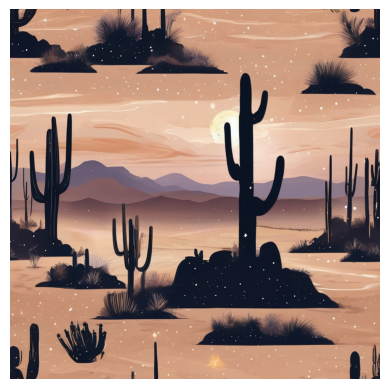

An abstract representation of emotions, using vibrant colors and fluid shapes to convey the complexity of human feelings. Swirls of reds, blues, and yellows blend together, creating a dynamic visual that captures joy, sadness, and tranquility in a single frame.


An abstract representation of emotions, using vibrant colors and fluid shapes to convey the complexity of human 
feelings. Swirls of reds, blues, and yellows blend together, creating a dynamic visual that captures joy, sadness, 
and tranquility in a single frame.

  0%|          | 0/50 [00:00<?, ?it/s]

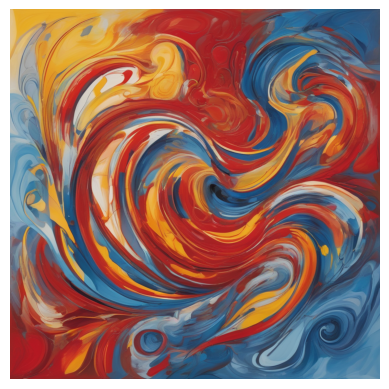

A breathtaking view of the Grand Canyon at sunset, where the sun casts warm hues of orange and pink across the dramatic rock formations. The Colorado River winds through the canyon floor, reflecting the colors of the sky. This natural wonder showcases the beauty of the earth's geological history.


A breathtaking view of the Grand Canyon at sunset, where the sun casts warm hues of orange and pink across the 
dramatic rock formations. The Colorado River winds through the canyon floor, reflecting the colors of the sky. This
natural wonder showcases the beauty of the earth's geological history.

  0%|          | 0/50 [00:00<?, ?it/s]

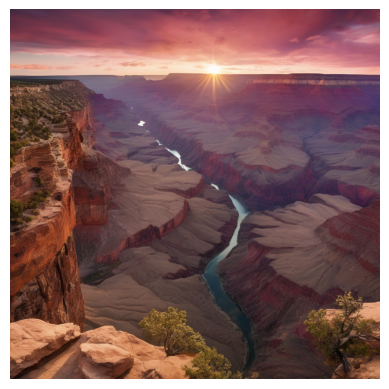

A traditional Japanese temple surrounded by vibrant autumn foliage, with maple leaves in shades of red and gold falling gently to the ground. The temple's architecture is a stunning example of cultural heritage, harmonizing with the natural beauty of the changing seasons.


A traditional Japanese temple surrounded by vibrant autumn foliage, with maple leaves in shades of red and gold 
falling gently to the ground. The temple's architecture is a stunning example of cultural heritage, harmonizing 
with the natural beauty of the changing seasons.

  0%|          | 0/50 [00:00<?, ?it/s]

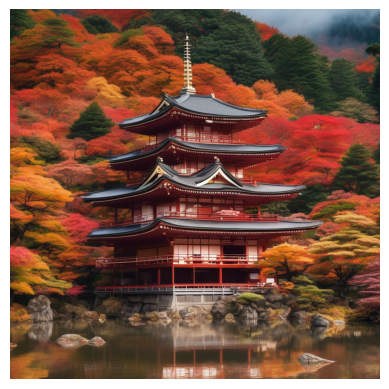

A lively festival scene in Rio de Janeiro, filled with samba dancers in colorful costumes, vibrant decorations, and an energetic atmosphere. The streets are alive with music and laughter as people celebrate, showcasing the rich cultural heritage of Brazil.


A lively festival scene in Rio de Janeiro, filled with samba dancers in colorful costumes, vibrant decorations, and
an energetic atmosphere. The streets are alive with music and laughter as people celebrate, showcasing the rich 
cultural heritage of Brazil.

  0%|          | 0/50 [00:00<?, ?it/s]

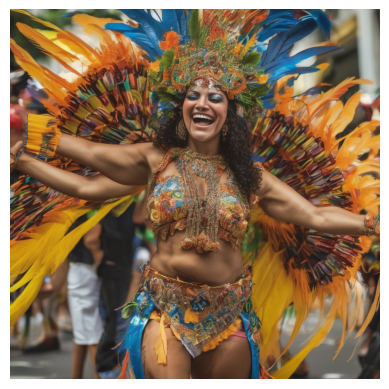

A panoramic view of the Northern Lights dancing over a snowy landscape in Iceland. The sky is illuminated with shades of green, purple, and blue, creating a magical display. In the foreground, a cozy cabin with smoke rising from the chimney adds warmth to the cold, pristine environment.


A panoramic view of the Northern Lights dancing over a snowy landscape in Iceland. The sky is illuminated with 
shades of green, purple, and blue, creating a magical display. In the foreground, a cozy cabin with smoke rising 
from the chimney adds warmth to the cold, pristine environment.

  0%|          | 0/50 [00:00<?, ?it/s]

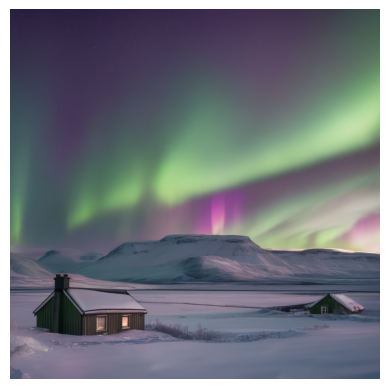

In [6]:
# Initialize the console
console = Console()

# List of random styles
styles = [
    "bold yellow on black",
    "bold white on blue",
    "bold magenta on green",
    "bold cyan on black",
    "bold red on white",
    "bold green on black",
    "bold blue on yellow",
    "bold black on magenta",
]

# Array of detailed prompts for image generation
prompts = [
    "A breathtaking sunrise over the majestic Himalayas, where the first rays of sunlight illuminate the snow-capped peaks. Below, a lush valley shrouded in mist reveals terraced fields and small villages, with colorful prayer flags fluttering in the gentle breeze, symbolizing peace and spirituality.",
    "An enchanting underwater scene in the Great Barrier Reef, showcasing a vibrant coral ecosystem. Schools of tropical fish in brilliant hues swim among the corals, while a graceful sea turtle glides effortlessly through the crystal-clear water. Sunlight filters down from the surface, creating a magical atmosphere filled with life.",
    "A dense and thriving rainforest, where towering trees with thick canopies create a natural cathedral. Exotic birds with vivid plumage flit between branches, while colorful orchids and ferns blanket the forest floor. A serene waterfall cascades into a tranquil pool, surrounded by lush greenery and the sounds of nature.",
    "A futuristic cityscape at night, where sleek skyscrapers adorned with holographic advertisements rise against a starry sky. Flying cars zip through the air, leaving trails of light, while pedestrians walk along illuminated walkways. The city is a blend of nature and technology, with vertical gardens integrated into the architecture.",
    "An astronaut floating in the vastness of space, with Earth visible in the background, a vibrant blue and green marble against the black void. Stars twinkle in the distance, and a nearby satellite orbits silently. The astronaut's suit reflects the sunlight, creating a stunning contrast against the infinite cosmos.",
    "A close-up view of a high-tech computer circuit board, filled with intricate designs and glowing components. The board is alive with activity, showcasing data transmission through light pulses. This visual representation of technology highlights the complexity and beauty of modern electronics.",
    "A diverse group of people from various cultures gathered at a bustling street market, sharing a meal together. Colorful stalls display an array of dishes from around the world, with spices and aromas filling the air. Laughter and conversation blend as they enjoy traditional foods, celebrating unity in diversity.",
    "An artist passionately painting a large mural on a city wall, capturing the essence of urban life and cultural diversity. The mural features vibrant colors and intricate designs, depicting scenes of community, history, and hope. Bystanders watch in awe, inspired by the creativity and expression of the artist.",
    "A tranquil scene in a Japanese Zen garden, where a person practices mindfulness meditation. Surrounded by meticulously raked gravel, carefully placed rocks, and blooming cherry blossom trees, the individual finds peace and serenity. Soft petals fall gently around them, enhancing the atmosphere of calm.",
    "A majestic lion resting on a sunlit rock in the African savannah, its golden mane glistening in the warm light. The vast landscape stretches out behind it, dotted with acacia trees and distant mountains. This powerful creature embodies strength and grace, a true king of the wild.",
    "A playful dolphin leaping out of the ocean waves during a stunning sunset. The sky is painted in shades of orange, pink, and purple, reflecting on the water's surface. The dolphin's sleek body arcs gracefully through the air, capturing the joy and freedom of life in the sea.",
    "A close-up of a colorful butterfly perched delicately on a vibrant flower in a blooming garden. The intricate patterns on its wings are illuminated by sunlight, showcasing nature's artistry. Nearby, other insects buzz around, contributing to the lively atmosphere of the garden.",
    "A vast field of wildflowers in full bloom, showcasing a riot of colors—reds, yellows, blues, and purples. Bees and butterflies flit from flower to flower, pollinating as they go. In the distance, rolling hills provide a picturesque backdrop, creating a scene of natural beauty and harmony.",
    "A tranquil rice terrace in Bali, where lush green fields cascade down the hillside in a series of steps. Farmers work diligently, planting and harvesting rice, while the sun sets behind the mountains, casting a golden glow over the landscape. This image captures the beauty of agriculture and tradition.",
    "A stunning desert landscape featuring towering saguaro cacti under a starry night sky. The Milky Way stretches across the heavens, illuminating the desert floor with a soft glow. The cacti stand tall and proud, symbolizing resilience in the harsh environment.",
    "An abstract representation of emotions, using vibrant colors and fluid shapes to convey the complexity of human feelings. Swirls of reds, blues, and yellows blend together, creating a dynamic visual that captures joy, sadness, and tranquility in a single frame.",
    "A breathtaking view of the Grand Canyon at sunset, where the sun casts warm hues of orange and pink across the dramatic rock formations. The Colorado River winds through the canyon floor, reflecting the colors of the sky. This natural wonder showcases the beauty of the earth's geological history.",
    "A traditional Japanese temple surrounded by vibrant autumn foliage, with maple leaves in shades of red and gold falling gently to the ground. The temple's architecture is a stunning example of cultural heritage, harmonizing with the natural beauty of the changing seasons.",
    "A lively festival scene in Rio de Janeiro, filled with samba dancers in colorful costumes, vibrant decorations, and an energetic atmosphere. The streets are alive with music and laughter as people celebrate, showcasing the rich cultural heritage of Brazil.",
    "A panoramic view of the Northern Lights dancing over a snowy landscape in Iceland. The sky is illuminated with shades of green, purple, and blue, creating a magical display. In the foreground, a cozy cabin with smoke rising from the chimney adds warmth to the cold, pristine environment."
]

# Iteration loop to display one prompt at a time
for prompt in prompts:
    print(prompt)
    
    # Randomly select a style from the styles list
    random_style = random.choice(styles)
    
    # Create highlighted text for the prompt with the random style
    highlighted_prompt = Text(prompt, style=random_style)
    
    # Print the highlighted prompt
    console.print(highlighted_prompt)
    
    # Generate the image
    img = generate_stable_diffusion_image(prompt)
    

    # Display the image
    if img is not None:
        plt.imshow(img)
        plt.axis('off')  # Hide axes
        plt.show()
        
    time.sleep(2)  # Wait for 2 seconds before showing the next image

# These prompts were generated using a Prompt itself - I leveraged Perplexity.AI

In [7]:
prompts = [
    "A serene sunset over a tranquil lake, with vibrant orange and pink hues reflecting on the water, surrounded by lush green trees and distant mountains, in the style of a classic oil painting.",
    "A magical forest filled with colorful flowers and whimsical creatures, including fairies and butterflies, under a bright blue sky with fluffy white clouds, reminiscent of a children's storybook illustration.",
    "A snowy winter landscape, featuring a cozy cabin with smoke rising from the chimney, surrounded by tall pine trees and a frozen pond, illuminated by the soft glow of the moonlight.",
    "A playful puppy chasing butterflies in a sunny garden, with blooming flowers and a bright blue sky, capturing the joy of childhood and the innocence of pets.",
    "A majestic lion resting under a tree in the savannah, with golden grass swaying in the breeze and a vibrant sunset in the background, showcasing the beauty of wildlife.",
    "A colorful underwater scene with tropical fish and coral reefs, highlighting the diversity of marine life, with sunlight filtering through the water, creating a magical atmosphere.",
    "A whimsical castle in the clouds, surrounded by floating islands and rainbow-colored hot air balloons, evoking a sense of wonder and adventure, inspired by fairy tales.",
    "A friendly dragon playing with children in a meadow, with colorful flowers and butterflies, illustrating a scene of friendship and fantasy.",
    "An enchanted library filled with magical books and glowing orbs, where a young wizard is reading under a starry night sky, capturing the essence of imagination and learning.",
    "A group of children playing soccer in a park, with bright green grass, trees in the background, and a blue sky, showcasing the joy of outdoor activities and teamwork.",
    "A family having a picnic on a sunny day, with a checkered blanket, delicious food, and laughter, surrounded by nature, emphasizing the importance of family and togetherness.",
    "A cozy café scene with people enjoying coffee and pastries, featuring warm lighting, bookshelves, and a friendly barista, reflecting a sense of community and relaxation.",
    "A child painting at an easel in a sunny room, surrounded by colorful paints and brushes, capturing the creativity and joy of artistic expression.",
    "A vibrant art studio filled with various art supplies, where artists are working on different projects, showcasing the beauty of creativity and collaboration.",
    "A whimsical craft fair with booths displaying handmade items, featuring cheerful vendors and visitors, highlighting the charm of local artisans and creativity.",
    "A peaceful beach scene with children building sandcastles, seagulls flying overhead, and waves gently lapping at the shore, embodying the spirit of summer fun.",
    "An adorable baby elephant playing with a butterfly in a lush green jungle, symbolizing innocence and the beauty of nature.",
    "A group of friends camping under a starry sky, with a glowing campfire and tents, capturing the essence of adventure and friendship.",
    "A vibrant farmer's market filled with fresh fruits and vegetables, where families are shopping and enjoying the lively atmosphere.",
    "A colorful hot air balloon festival, with balloons of all shapes and sizes floating in the sky, creating a festive and joyful scene.",
    "A cheerful snowman wearing a scarf and hat, surrounded by children playing in the snow, illustrating the joy of winter activities.",
    "A magical treehouse nestled in the branches of a giant tree, with a rope ladder and fairy lights, inviting children to explore and play.",
    "A beautiful garden filled with blooming flowers and buzzing bees, showcasing the harmony of nature and the importance of pollinators.",
    "A futuristic city skyline at dusk, with flying cars and glowing buildings, capturing the imagination of what the future could hold.",
    "A cozy reading nook with a child curled up with a book, surrounded by soft pillows and warm lighting, promoting the love of reading.",
    "A vibrant carnival scene with colorful rides, games, and happy families enjoying the festivities, filled with laughter and excitement.",
    "A majestic whale swimming gracefully in the ocean, with sunlight streaming down through the water, highlighting the beauty of marine life.",
    "A whimsical tea party with stuffed animals and children, set in a colorful garden, capturing the essence of childhood imagination.",
    "A friendly robot helping children with their homework in a bright classroom, showcasing the positive impact of technology on learning.",
    "A picturesque village during autumn, with colorful leaves falling from trees and children playing in the leaves, celebrating the beauty of the season.",
    "A magical fairy garden with tiny houses and sparkling lights, inhabited by friendly fairies, creating a sense of wonder and enchantment.",
    "A joyful family celebrating a birthday party, with balloons, cake, and laughter, emphasizing the importance of family traditions.",
    "A charming bakery filled with delicious pastries and treats, with a friendly baker serving customers, illustrating the joy of food and community.",
    "A young scientist conducting an experiment in a colorful lab, surrounded by beakers and bubbling potions, promoting curiosity and learning.",
    "A tranquil Zen garden with a child meditating, surrounded by rocks, sand, and carefully placed plants, emphasizing peace and mindfulness.",
    "A vibrant street art scene, with artists painting murals on walls, showcasing the beauty of creativity and self-expression.",
    "A magical winter wonderland with twinkling lights, ice skating, and snow-covered trees, capturing the joy of the holiday season.",
    "A friendly alien visiting Earth, exploring a park filled with children playing, illustrating the theme of friendship across worlds.",
    "A colorful parade with floats, dancers, and musicians celebrating a cultural festival, showcasing diversity and community spirit.",
    "A child flying a kite on a windy day, with a bright blue sky and fluffy clouds, capturing the joy of outdoor play.",
    "A cozy family movie night with popcorn, blankets, and laughter, emphasizing the importance of spending quality time together.",
    "A vibrant coral reef teeming with colorful fish and marine life, showcasing the beauty and diversity of underwater ecosystems.",
    "A magical night sky filled with shooting stars and constellations, where children are lying on the grass, dreaming and making wishes.",
    "A friendly bear having a picnic with woodland animals, surrounded by trees and flowers, illustrating the beauty of friendship in nature.",
    "A child exploring a magical cave filled with glowing crystals and treasures, capturing the spirit of adventure and discovery.",
    "A whimsical playground with unique equipment, where children are laughing and playing, promoting the joy of outdoor activities.",
    "A peaceful sunset over rolling hills, with a winding river and wildflowers, creating a sense of tranquility and beauty in nature.",
    "A vibrant and colorful dragon parade, with dancers and musicians, celebrating culture and creativity in a festive atmosphere."
]

A serene sunset over a tranquil lake, with vibrant orange and pink hues reflecting on the water, surrounded by lush green trees and distant mountains, in the style of a classic oil painting.


A serene sunset over a tranquil lake, with vibrant orange and pink hues reflecting on the water, surrounded by lush
green trees and distant mountains, in the style of a classic oil painting.

  0%|          | 0/50 [00:00<?, ?it/s]

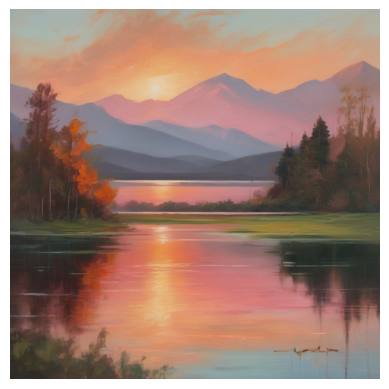

A magical forest filled with colorful flowers and whimsical creatures, including fairies and butterflies, under a bright blue sky with fluffy white clouds, reminiscent of a children's storybook illustration.


A magical forest filled with colorful flowers and whimsical creatures, including fairies and butterflies, under a 
bright blue sky with fluffy white clouds, reminiscent of a children's storybook illustration.

  0%|          | 0/50 [00:00<?, ?it/s]

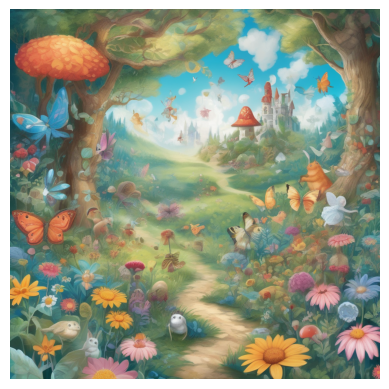

A snowy winter landscape, featuring a cozy cabin with smoke rising from the chimney, surrounded by tall pine trees and a frozen pond, illuminated by the soft glow of the moonlight.


A snowy winter landscape, featuring a cozy cabin with smoke rising from the chimney, surrounded by tall pine trees 
and a frozen pond, illuminated by the soft glow of the moonlight.

  0%|          | 0/50 [00:00<?, ?it/s]

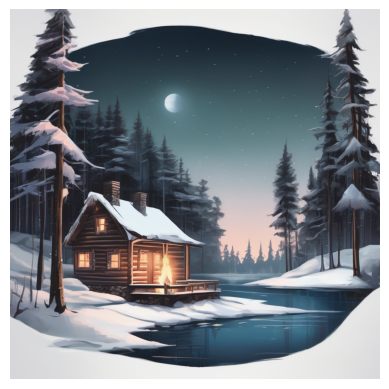

A playful puppy chasing butterflies in a sunny garden, with blooming flowers and a bright blue sky, capturing the joy of childhood and the innocence of pets.


A playful puppy chasing butterflies in a sunny garden, with blooming flowers and a bright blue sky, capturing the 
joy of childhood and the innocence of pets.

  0%|          | 0/50 [00:00<?, ?it/s]

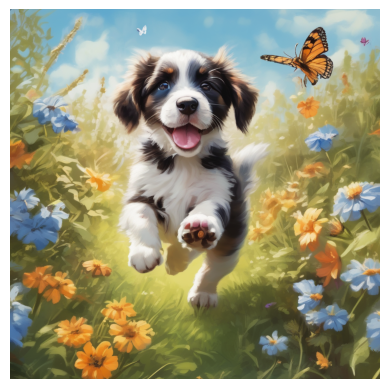

A majestic lion resting under a tree in the savannah, with golden grass swaying in the breeze and a vibrant sunset in the background, showcasing the beauty of wildlife.


A majestic lion resting under a tree in the savannah, with golden grass swaying in the breeze and a vibrant sunset 
in the background, showcasing the beauty of wildlife.

  0%|          | 0/50 [00:00<?, ?it/s]

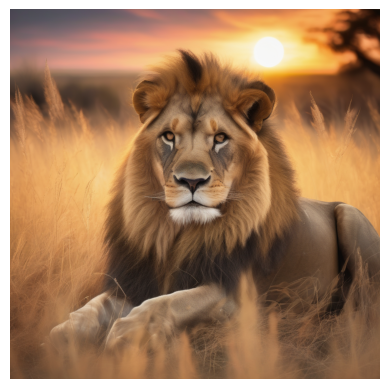

A colorful underwater scene with tropical fish and coral reefs, highlighting the diversity of marine life, with sunlight filtering through the water, creating a magical atmosphere.


A colorful underwater scene with tropical fish and coral reefs, highlighting the diversity of marine life, with 
sunlight filtering through the water, creating a magical atmosphere.

  0%|          | 0/50 [00:00<?, ?it/s]

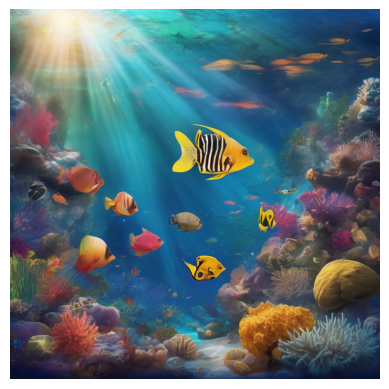

A whimsical castle in the clouds, surrounded by floating islands and rainbow-colored hot air balloons, evoking a sense of wonder and adventure, inspired by fairy tales.


A whimsical castle in the clouds, surrounded by floating islands and rainbow-colored hot air balloons, evoking a 
sense of wonder and adventure, inspired by fairy tales.

  0%|          | 0/50 [00:00<?, ?it/s]

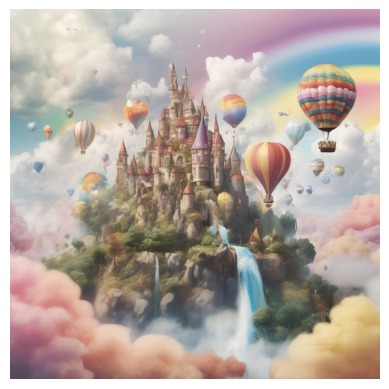

A friendly dragon playing with children in a meadow, with colorful flowers and butterflies, illustrating a scene of friendship and fantasy.


A friendly dragon playing with children in a meadow, with colorful flowers and butterflies, illustrating a scene of
friendship and fantasy.

  0%|          | 0/50 [00:00<?, ?it/s]

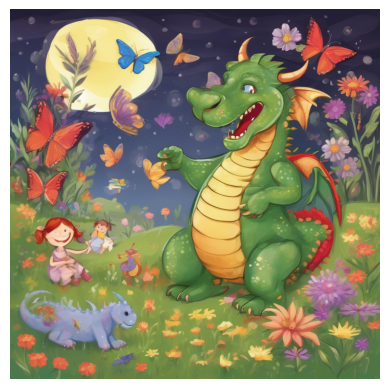

An enchanted library filled with magical books and glowing orbs, where a young wizard is reading under a starry night sky, capturing the essence of imagination and learning.


An enchanted library filled with magical books and glowing orbs, where a young wizard is reading under a starry 
night sky, capturing the essence of imagination and learning.

  0%|          | 0/50 [00:00<?, ?it/s]

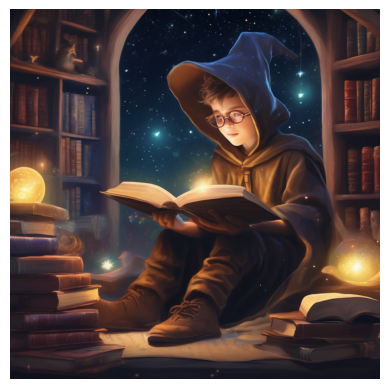

A group of children playing soccer in a park, with bright green grass, trees in the background, and a blue sky, showcasing the joy of outdoor activities and teamwork.


A group of children playing soccer in a park, with bright green grass, trees in the background, and a blue sky, 
showcasing the joy of outdoor activities and teamwork.

  0%|          | 0/50 [00:00<?, ?it/s]

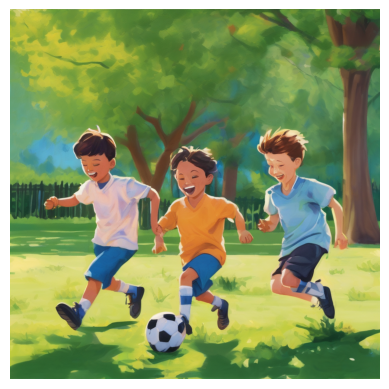

A family having a picnic on a sunny day, with a checkered blanket, delicious food, and laughter, surrounded by nature, emphasizing the importance of family and togetherness.


A family having a picnic on a sunny day, with a checkered blanket, delicious food, and laughter, surrounded by 
nature, emphasizing the importance of family and togetherness.

  0%|          | 0/50 [00:00<?, ?it/s]

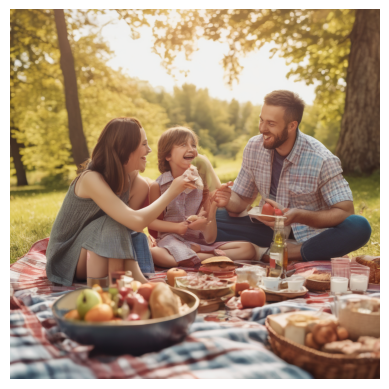

A cozy café scene with people enjoying coffee and pastries, featuring warm lighting, bookshelves, and a friendly barista, reflecting a sense of community and relaxation.


A cozy café scene with people enjoying coffee and pastries, featuring warm lighting, bookshelves, and a friendly 
barista, reflecting a sense of community and relaxation.

  0%|          | 0/50 [00:00<?, ?it/s]

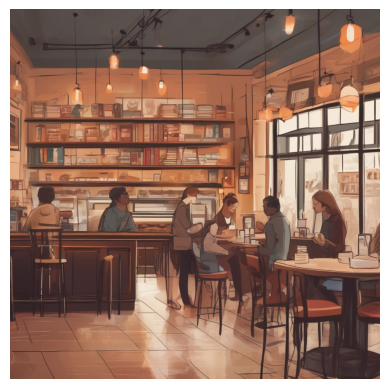

A child painting at an easel in a sunny room, surrounded by colorful paints and brushes, capturing the creativity and joy of artistic expression.


A child painting at an easel in a sunny room, surrounded by colorful paints and brushes, capturing the creativity 
and joy of artistic expression.

  0%|          | 0/50 [00:00<?, ?it/s]

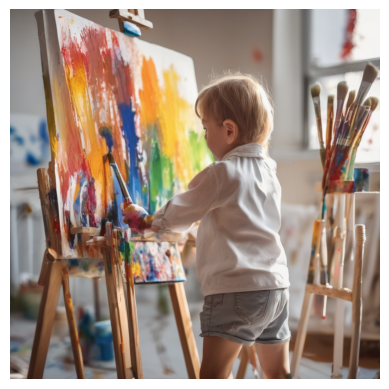

A vibrant art studio filled with various art supplies, where artists are working on different projects, showcasing the beauty of creativity and collaboration.


A vibrant art studio filled with various art supplies, where artists are working on different projects, showcasing 
the beauty of creativity and collaboration.

  0%|          | 0/50 [00:00<?, ?it/s]

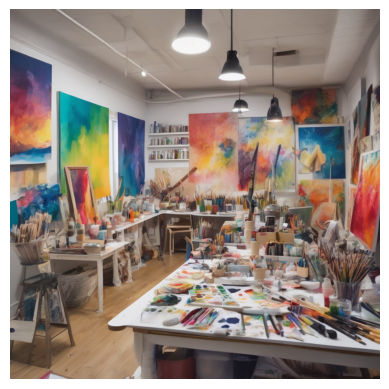

A whimsical craft fair with booths displaying handmade items, featuring cheerful vendors and visitors, highlighting the charm of local artisans and creativity.


A whimsical craft fair with booths displaying handmade items, featuring cheerful vendors and visitors, highlighting
the charm of local artisans and creativity.

  0%|          | 0/50 [00:00<?, ?it/s]

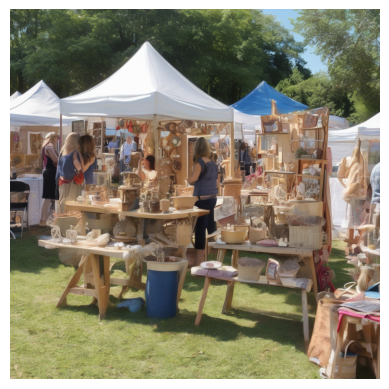

A peaceful beach scene with children building sandcastles, seagulls flying overhead, and waves gently lapping at the shore, embodying the spirit of summer fun.


A peaceful beach scene with children building sandcastles, seagulls flying overhead, and waves gently lapping at 
the shore, embodying the spirit of summer fun.

  0%|          | 0/50 [00:00<?, ?it/s]

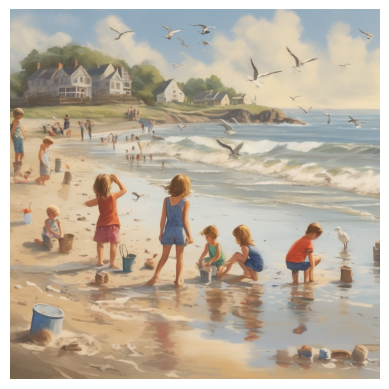

An adorable baby elephant playing with a butterfly in a lush green jungle, symbolizing innocence and the beauty of nature.


An adorable baby elephant playing with a butterfly in a lush green jungle, symbolizing innocence and the beauty of 
nature.

  0%|          | 0/50 [00:00<?, ?it/s]

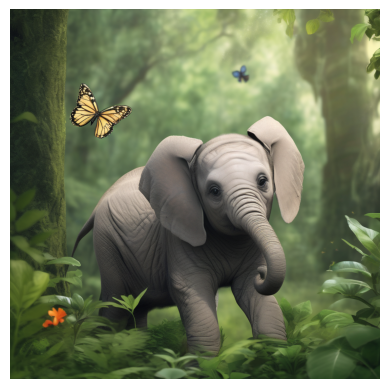

A group of friends camping under a starry sky, with a glowing campfire and tents, capturing the essence of adventure and friendship.


A group of friends camping under a starry sky, with a glowing campfire and tents, capturing the essence of 
adventure and friendship.

  0%|          | 0/50 [00:00<?, ?it/s]

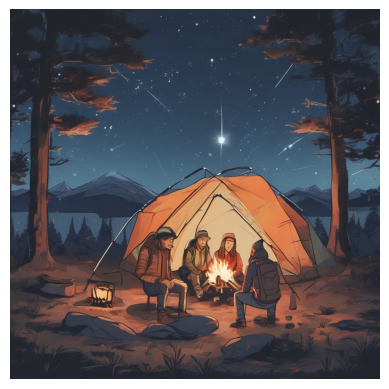

A vibrant farmer's market filled with fresh fruits and vegetables, where families are shopping and enjoying the lively atmosphere.


A vibrant farmer's market filled with fresh fruits and vegetables, where families are shopping and enjoying the 
lively atmosphere.

  0%|          | 0/50 [00:00<?, ?it/s]

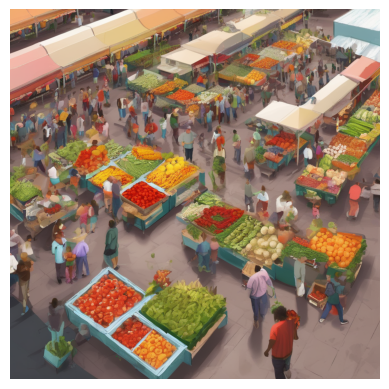

A colorful hot air balloon festival, with balloons of all shapes and sizes floating in the sky, creating a festive and joyful scene.


A colorful hot air balloon festival, with balloons of all shapes and sizes floating in the sky, creating a festive 
and joyful scene.

  0%|          | 0/50 [00:00<?, ?it/s]

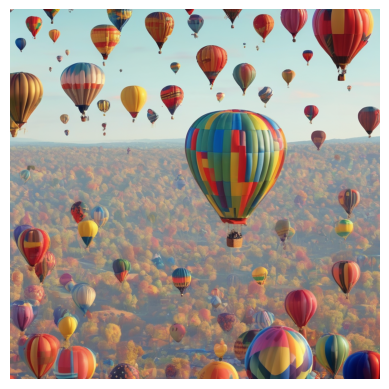

A cheerful snowman wearing a scarf and hat, surrounded by children playing in the snow, illustrating the joy of winter activities.


A cheerful snowman wearing a scarf and hat, surrounded by children playing in the snow, illustrating the joy of 
winter activities.

  0%|          | 0/50 [00:00<?, ?it/s]

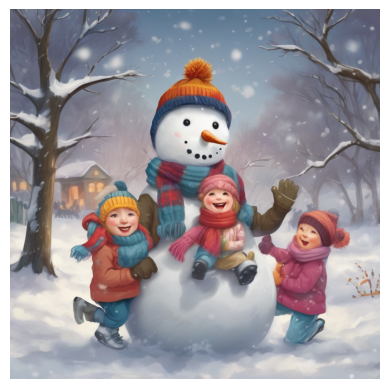

A magical treehouse nestled in the branches of a giant tree, with a rope ladder and fairy lights, inviting children to explore and play.


A magical treehouse nestled in the branches of a giant tree, with a rope ladder and fairy lights, inviting children
to explore and play.

  0%|          | 0/50 [00:00<?, ?it/s]

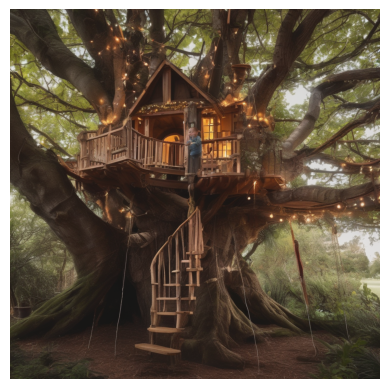

A beautiful garden filled with blooming flowers and buzzing bees, showcasing the harmony of nature and the importance of pollinators.


A beautiful garden filled with blooming flowers and buzzing bees, showcasing the harmony of nature and the 
importance of pollinators.

  0%|          | 0/50 [00:00<?, ?it/s]

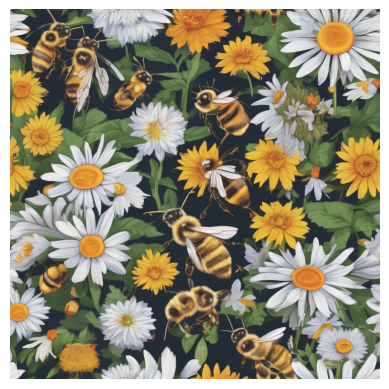

A futuristic city skyline at dusk, with flying cars and glowing buildings, capturing the imagination of what the future could hold.


A futuristic city skyline at dusk, with flying cars and glowing buildings, capturing the imagination of what the 
future could hold.

  0%|          | 0/50 [00:00<?, ?it/s]

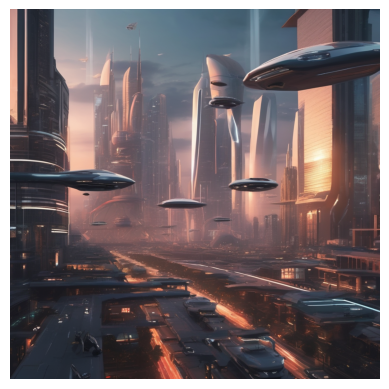

A cozy reading nook with a child curled up with a book, surrounded by soft pillows and warm lighting, promoting the love of reading.


A cozy reading nook with a child curled up with a book, surrounded by soft pillows and warm lighting, promoting the
love of reading.

  0%|          | 0/50 [00:00<?, ?it/s]

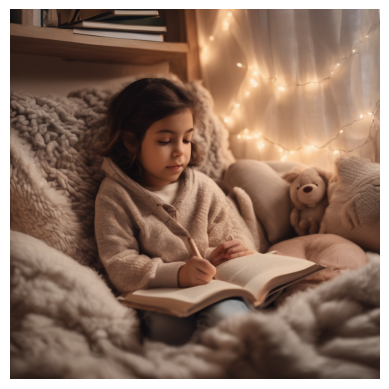

A vibrant carnival scene with colorful rides, games, and happy families enjoying the festivities, filled with laughter and excitement.


A vibrant carnival scene with colorful rides, games, and happy families enjoying the festivities, filled with 
laughter and excitement.

  0%|          | 0/50 [00:00<?, ?it/s]

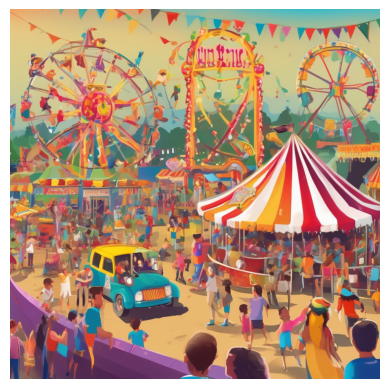

A majestic whale swimming gracefully in the ocean, with sunlight streaming down through the water, highlighting the beauty of marine life.


A majestic whale swimming gracefully in the ocean, with sunlight streaming down through the water, highlighting the
beauty of marine life.

  0%|          | 0/50 [00:00<?, ?it/s]

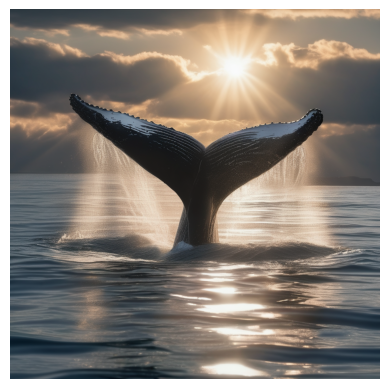

A whimsical tea party with stuffed animals and children, set in a colorful garden, capturing the essence of childhood imagination.


A whimsical tea party with stuffed animals and children, set in a colorful garden, capturing the essence of 
childhood imagination.

  0%|          | 0/50 [00:00<?, ?it/s]

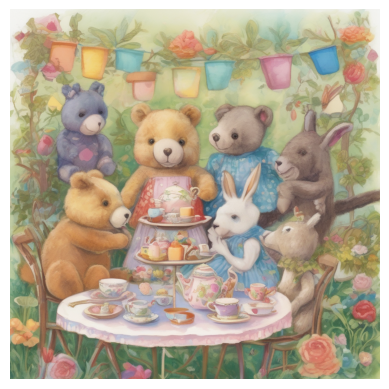

A friendly robot helping children with their homework in a bright classroom, showcasing the positive impact of technology on learning.


A friendly robot helping children with their homework in a bright classroom, showcasing the positive impact of 
technology on learning.

  0%|          | 0/50 [00:00<?, ?it/s]

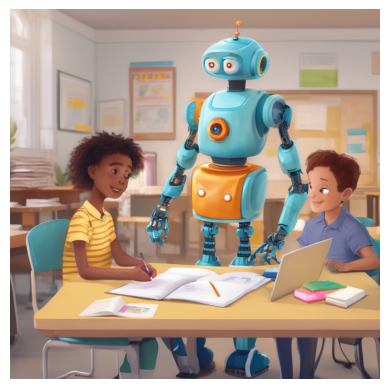

A picturesque village during autumn, with colorful leaves falling from trees and children playing in the leaves, celebrating the beauty of the season.


A picturesque village during autumn, with colorful leaves falling from trees and children playing in the leaves, 
celebrating the beauty of the season.

  0%|          | 0/50 [00:00<?, ?it/s]

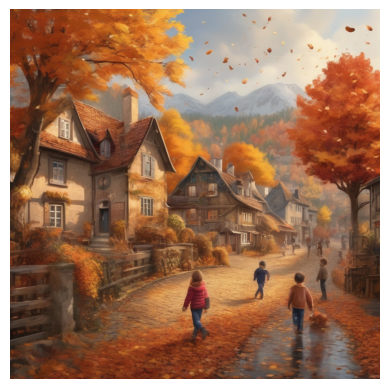

A magical fairy garden with tiny houses and sparkling lights, inhabited by friendly fairies, creating a sense of wonder and enchantment.


A magical fairy garden with tiny houses and sparkling lights, inhabited by friendly fairies, creating a sense of 
wonder and enchantment.

  0%|          | 0/50 [00:00<?, ?it/s]

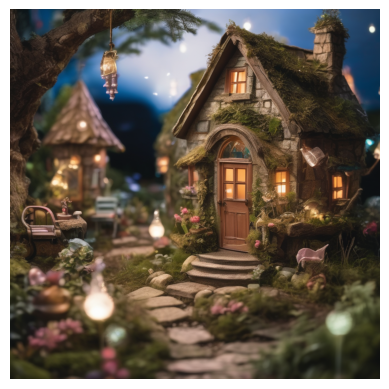

A joyful family celebrating a birthday party, with balloons, cake, and laughter, emphasizing the importance of family traditions.


A joyful family celebrating a birthday party, with balloons, cake, and laughter, emphasizing the importance of 
family traditions.

  0%|          | 0/50 [00:00<?, ?it/s]

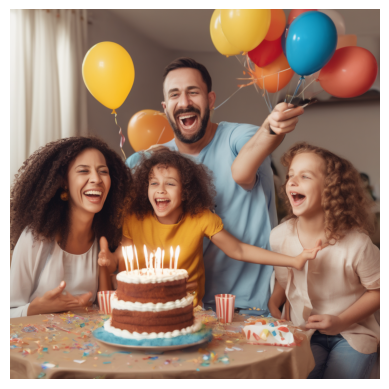

A charming bakery filled with delicious pastries and treats, with a friendly baker serving customers, illustrating the joy of food and community.


A charming bakery filled with delicious pastries and treats, with a friendly baker serving customers, illustrating 
the joy of food and community.

  0%|          | 0/50 [00:00<?, ?it/s]

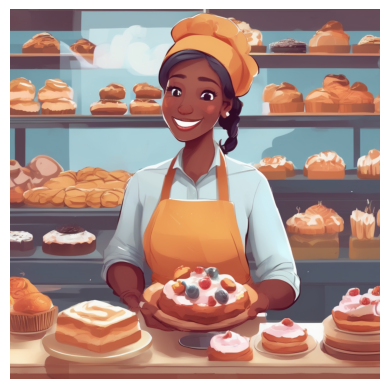

A young scientist conducting an experiment in a colorful lab, surrounded by beakers and bubbling potions, promoting curiosity and learning.


A young scientist conducting an experiment in a colorful lab, surrounded by beakers and bubbling potions, promoting
curiosity and learning.

  0%|          | 0/50 [00:00<?, ?it/s]

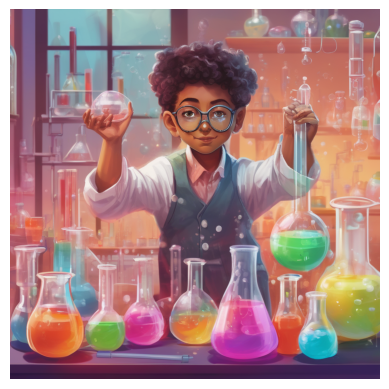

A tranquil Zen garden with a child meditating, surrounded by rocks, sand, and carefully placed plants, emphasizing peace and mindfulness.


A tranquil Zen garden with a child meditating, surrounded by rocks, sand, and carefully placed plants, emphasizing 
peace and mindfulness.

  0%|          | 0/50 [00:00<?, ?it/s]

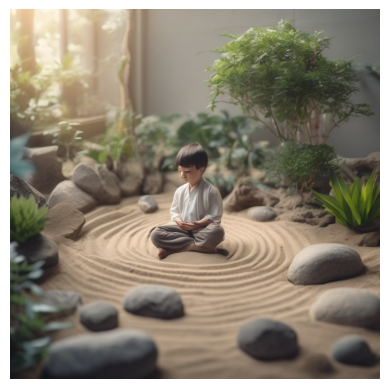

A vibrant street art scene, with artists painting murals on walls, showcasing the beauty of creativity and self-expression.


A vibrant street art scene, with artists painting murals on walls, showcasing the beauty of creativity and 
self-expression.

  0%|          | 0/50 [00:00<?, ?it/s]

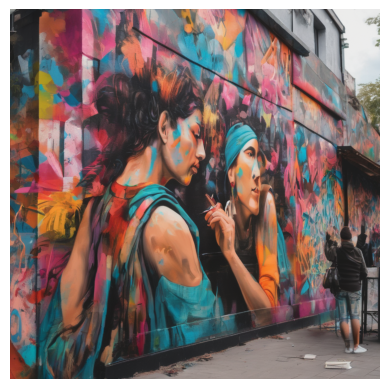

A magical winter wonderland with twinkling lights, ice skating, and snow-covered trees, capturing the joy of the holiday season.


A magical winter wonderland with twinkling lights, ice skating, and snow-covered trees, capturing the joy of the 
holiday season.

  0%|          | 0/50 [00:00<?, ?it/s]

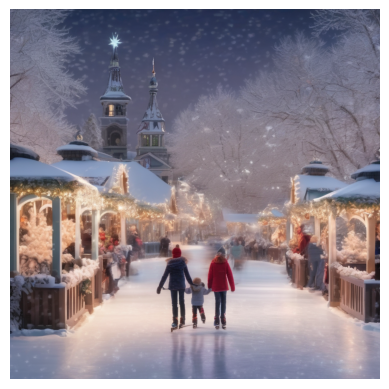

A friendly alien visiting Earth, exploring a park filled with children playing, illustrating the theme of friendship across worlds.


A friendly alien visiting Earth, exploring a park filled with children playing, illustrating the theme of 
friendship across worlds.

  0%|          | 0/50 [00:00<?, ?it/s]

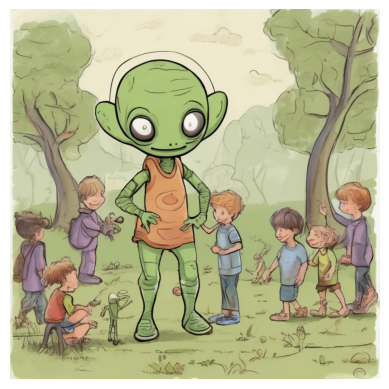

A colorful parade with floats, dancers, and musicians celebrating a cultural festival, showcasing diversity and community spirit.


A colorful parade with floats, dancers, and musicians celebrating a cultural festival, showcasing diversity and 
community spirit.

  0%|          | 0/50 [00:00<?, ?it/s]

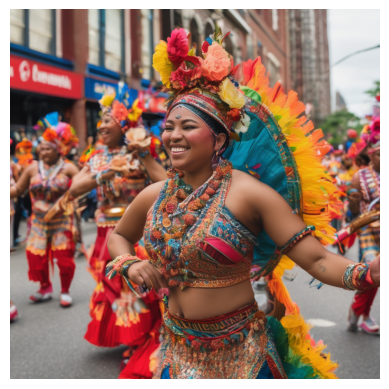

A child flying a kite on a windy day, with a bright blue sky and fluffy clouds, capturing the joy of outdoor play.


A child flying a kite on a windy day, with a bright blue sky and fluffy clouds, capturing the joy of outdoor play.

  0%|          | 0/50 [00:00<?, ?it/s]

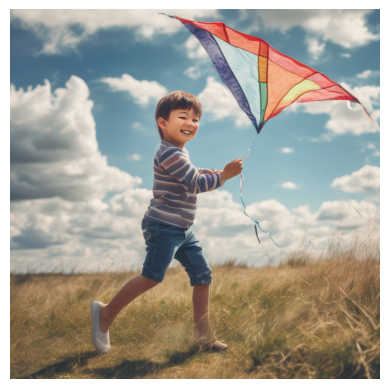

A cozy family movie night with popcorn, blankets, and laughter, emphasizing the importance of spending quality time together.


A cozy family movie night with popcorn, blankets, and laughter, emphasizing the importance of spending quality time
together.

  0%|          | 0/50 [00:00<?, ?it/s]

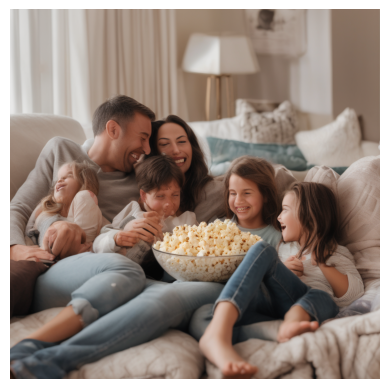

A vibrant coral reef teeming with colorful fish and marine life, showcasing the beauty and diversity of underwater ecosystems.


A vibrant coral reef teeming with colorful fish and marine life, showcasing the beauty and diversity of underwater 
ecosystems.

  0%|          | 0/50 [00:00<?, ?it/s]

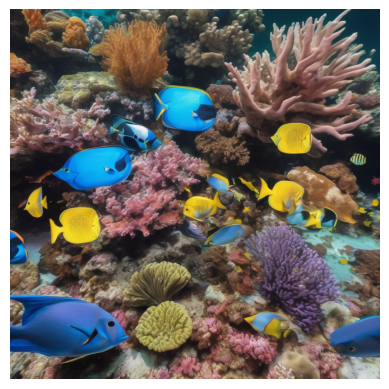

A magical night sky filled with shooting stars and constellations, where children are lying on the grass, dreaming and making wishes.


A magical night sky filled with shooting stars and constellations, where children are lying on the grass, dreaming 
and making wishes.

  0%|          | 0/50 [00:00<?, ?it/s]

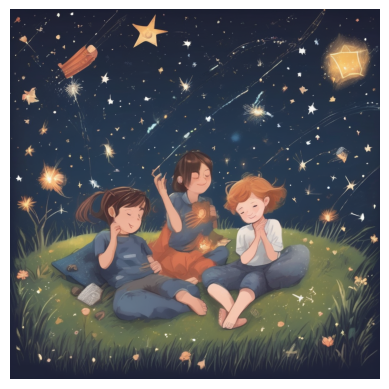

A friendly bear having a picnic with woodland animals, surrounded by trees and flowers, illustrating the beauty of friendship in nature.


A friendly bear having a picnic with woodland animals, surrounded by trees and flowers, illustrating the beauty of 
friendship in nature.

  0%|          | 0/50 [00:00<?, ?it/s]

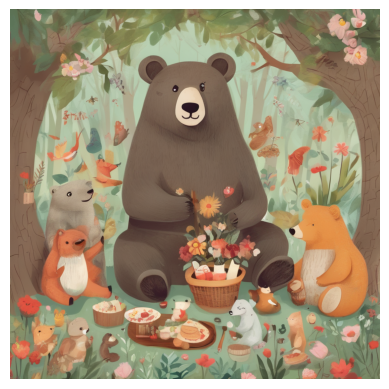

A child exploring a magical cave filled with glowing crystals and treasures, capturing the spirit of adventure and discovery.


A child exploring a magical cave filled with glowing crystals and treasures, capturing the spirit of adventure and 
discovery.

  0%|          | 0/50 [00:00<?, ?it/s]

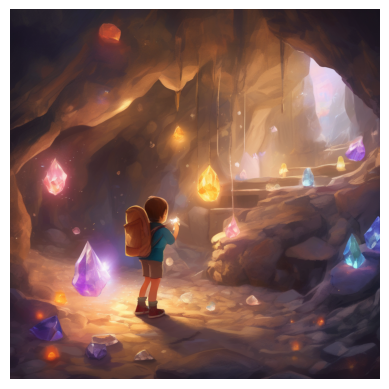

A whimsical playground with unique equipment, where children are laughing and playing, promoting the joy of outdoor activities.


A whimsical playground with unique equipment, where children are laughing and playing, promoting the joy of outdoor
activities.

  0%|          | 0/50 [00:00<?, ?it/s]

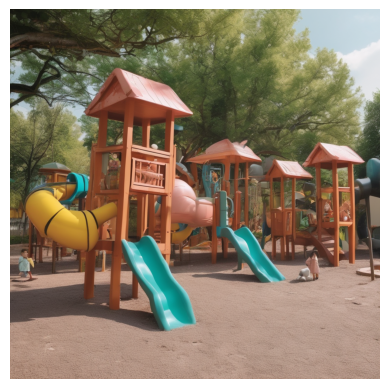

A peaceful sunset over rolling hills, with a winding river and wildflowers, creating a sense of tranquility and beauty in nature.


A peaceful sunset over rolling hills, with a winding river and wildflowers, creating a sense of tranquility and 
beauty in nature.

  0%|          | 0/50 [00:00<?, ?it/s]

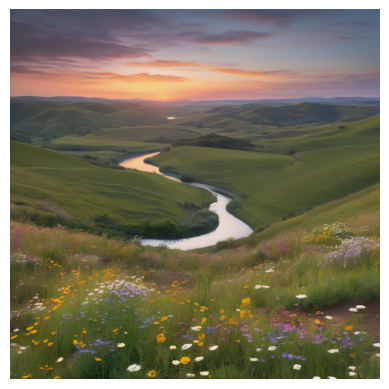

A vibrant and colorful dragon parade, with dancers and musicians, celebrating culture and creativity in a festive atmosphere.


A vibrant and colorful dragon parade, with dancers and musicians, celebrating culture and creativity in a festive 
atmosphere.

  0%|          | 0/50 [00:00<?, ?it/s]

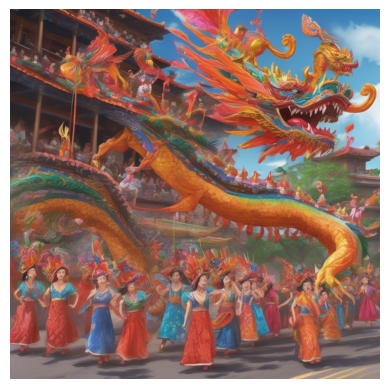

In [8]:
# Iteration loop to display one prompt at a time
for prompt in prompts:
    print(prompt)
    
    # Randomly select a style from the styles list
    random_style = random.choice(styles)
    
    # Create highlighted text for the prompt with the random style
    highlighted_prompt = Text(prompt, style=random_style)
    
    # Print the highlighted prompt
    console.print(highlighted_prompt)
    
    # Generate the image
    img = generate_stable_diffusion_image(prompt)
    

    # Display the image
    if img is not None:
        plt.imshow(img)
        plt.axis('off')  # Hide axes
        plt.show()
        
    time.sleep(2)  # Wait for 2 seconds before showing the next image

A majestic mountain landscape at sunrise, with golden light illuminating the peaks, 8K resolution, ultra-detailed, 
photorealistic.

  0%|          | 0/50 [00:00<?, ?it/s]

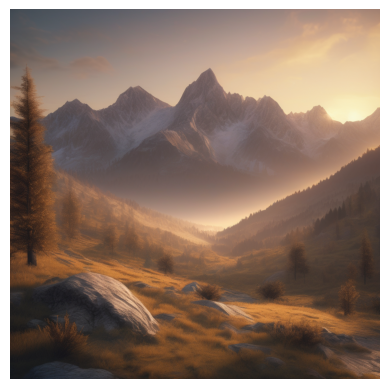

A vibrant underwater scene featuring a coral reef teeming with colorful fish, 4K resolution, highly detailed, 
natural lighting.

  0%|          | 0/50 [00:00<?, ?it/s]

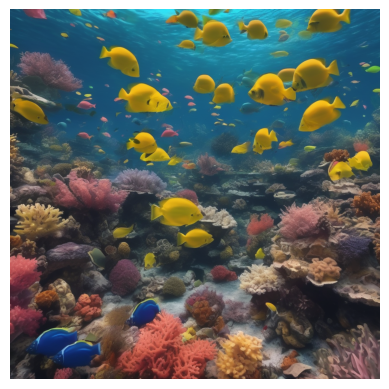

A futuristic city skyline at night, with neon lights reflecting on glass buildings, 16K resolution, cyberpunk 
style, high contrast.

  0%|          | 0/50 [00:00<?, ?it/s]

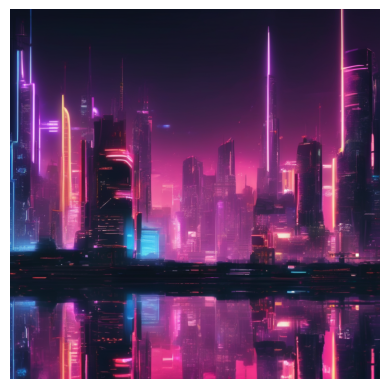

A serene Japanese garden in spring, cherry blossoms in full bloom, with a tranquil pond, 8K resolution, soft 
lighting, impressionistic style.

  0%|          | 0/50 [00:00<?, ?it/s]

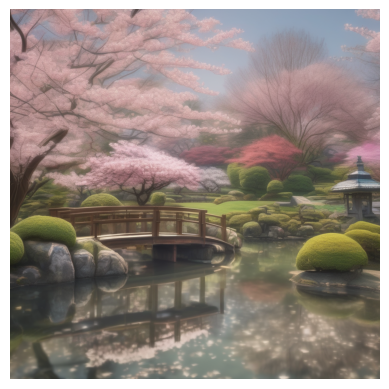

A cozy cabin in the woods during winter, smoke rising from the chimney, snow-covered trees, 4K resolution, warm and
inviting atmosphere.

  0%|          | 0/50 [00:00<?, ?it/s]

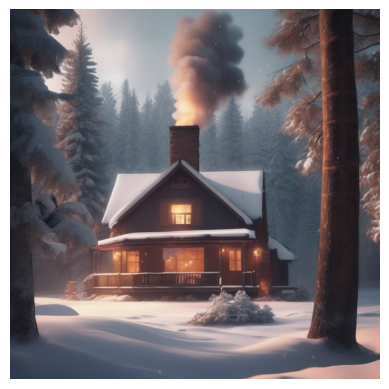

An astronaut floating in space, gazing at Earth from a distance, 8K resolution, realistic textures, deep space 
background.

  0%|          | 0/50 [00:00<?, ?it/s]

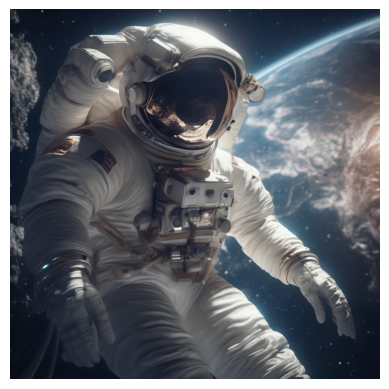

A whimsical fairy tale castle on a hill, surrounded by a magical forest, 16K resolution, vibrant colors, storybook 
illustration style.

  0%|          | 0/50 [00:00<?, ?it/s]

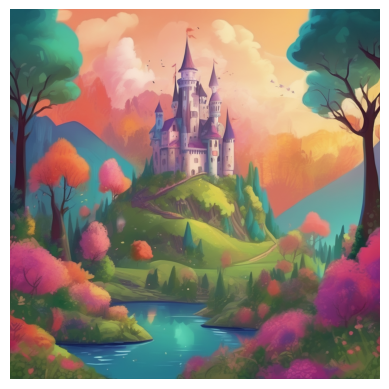

A close-up of a butterfly resting on a flower, showcasing intricate details and colors, 4K resolution, macro 
photography style.

  0%|          | 0/50 [00:00<?, ?it/s]

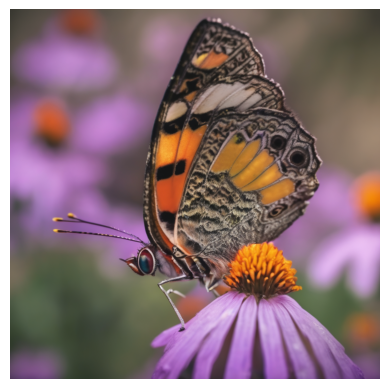

A bustling marketplace in an ancient city, with vendors selling colorful spices and textiles, 8K resolution, rich 
cultural details.

  0%|          | 0/50 [00:00<?, ?it/s]

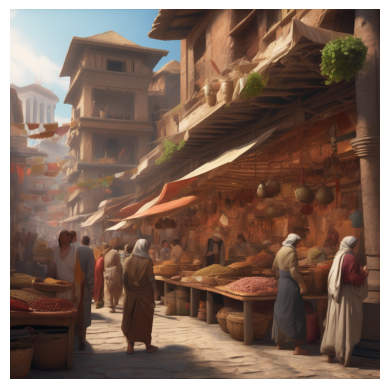

A dramatic sunset over a calm ocean, with waves gently lapping at the shore, 4K resolution, vibrant colors, serene 
atmosphere.

  0%|          | 0/50 [00:00<?, ?it/s]

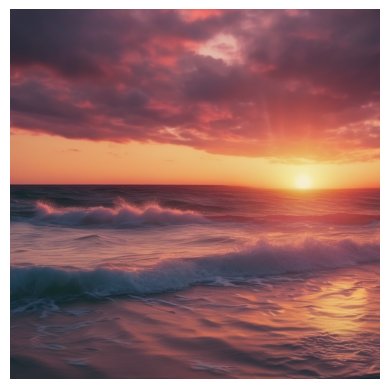

A fantasy landscape with floating islands and waterfalls, populated by mythical creatures, 16K resolution, highly 
imaginative.

  0%|          | 0/50 [00:00<?, ?it/s]

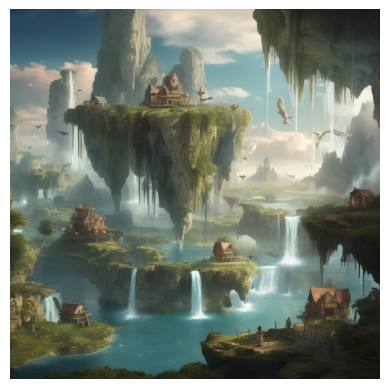

A portrait of a young woman with intricate tribal face paint, set against a colorful backdrop, 8K resolution, 
artistic style.

  0%|          | 0/50 [00:00<?, ?it/s]

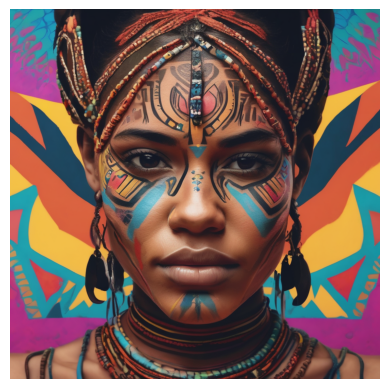

A futuristic vehicle racing through a neon-lit city, with motion blur effects, 4K resolution, dynamic action scene.

  0%|          | 0/50 [00:00<?, ?it/s]

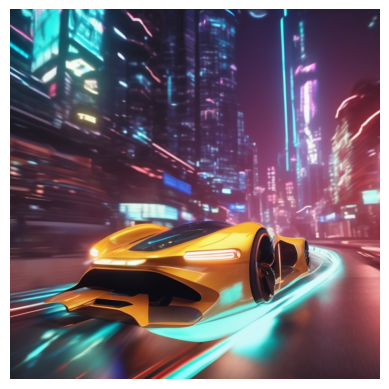

A detailed still life of fruits and flowers on a table, with soft natural lighting, 8K resolution, photorealistic 
style.

  0%|          | 0/50 [00:00<?, ?it/s]

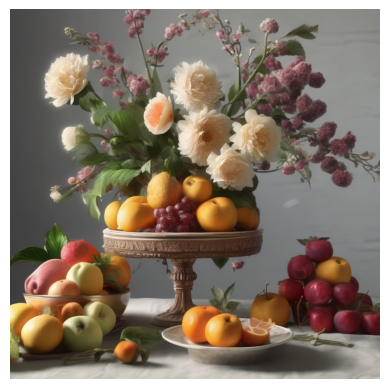

A magical library filled with ancient books and glowing orbs, 16K resolution, enchanting atmosphere, fantasy art 
style.

  0%|          | 0/50 [00:00<?, ?it/s]

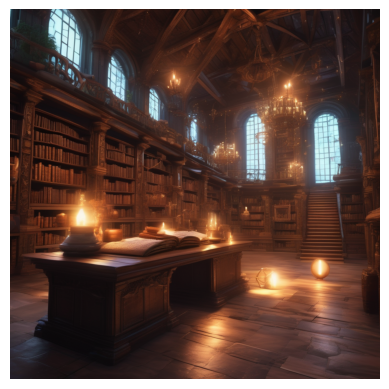

A serene beach at dawn, with gentle waves and seashells scattered on the sand, 4K resolution, peaceful and calming.

  0%|          | 0/50 [00:00<?, ?it/s]

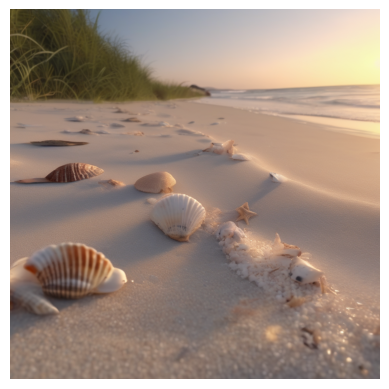

A vibrant street festival with dancers and musicians, celebrating culture and diversity, 8K resolution, lively and 
colorful.

  0%|          | 0/50 [00:00<?, ?it/s]

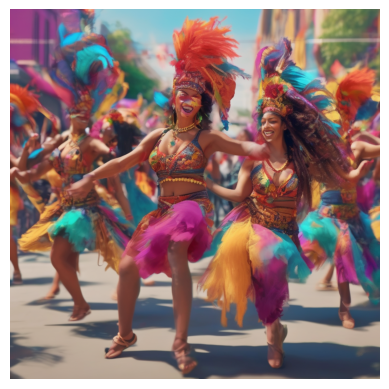

An elegant peacock displaying its feathers in a lush garden, 4K resolution, showcasing vivid colors and intricate 
patterns.

  0%|          | 0/50 [00:00<?, ?it/s]

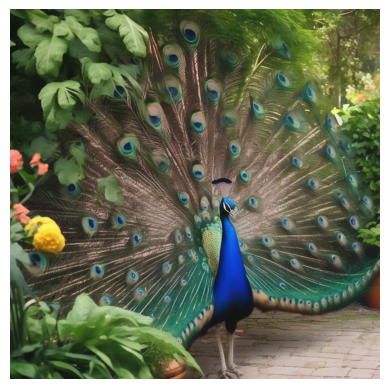

A dramatic mountain range reflected in a crystal-clear lake, 16K resolution, stunning natural beauty, high detail.

  0%|          | 0/50 [00:00<?, ?it/s]

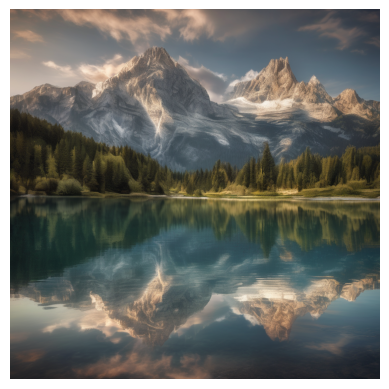

A cozy coffee shop interior with people reading and chatting, warm lighting, 8K resolution, inviting atmosphere.

  0%|          | 0/50 [00:00<?, ?it/s]

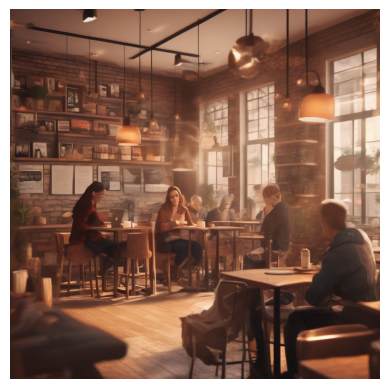

A fantasy dragon perched on a cliff, overlooking a vast kingdom, 4K resolution, epic and majestic.

  0%|          | 0/50 [00:00<?, ?it/s]

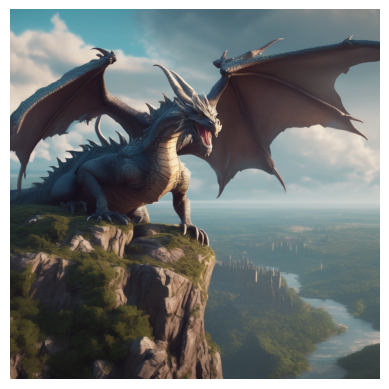

A close-up of a vintage watch with intricate gears and details, 8K resolution, showcasing craftsmanship and 
elegance.

  0%|          | 0/50 [00:00<?, ?it/s]

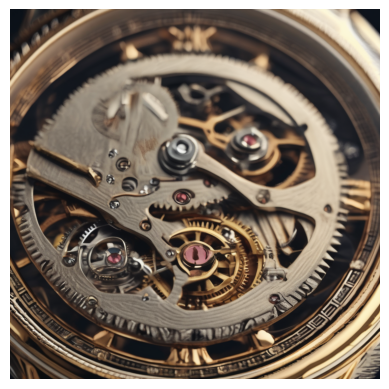

A lush rainforest with exotic plants and animals, sunlight filtering through the canopy, 16K resolution, vibrant 
colors.

  0%|          | 0/50 [00:00<?, ?it/s]

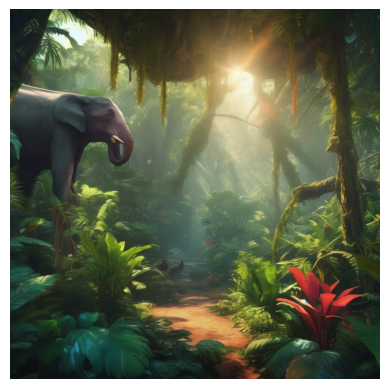

A whimsical hot air balloon festival in the sky, with colorful balloons floating above a picturesque landscape, 4K 
resolution.

  0%|          | 0/50 [00:00<?, ?it/s]

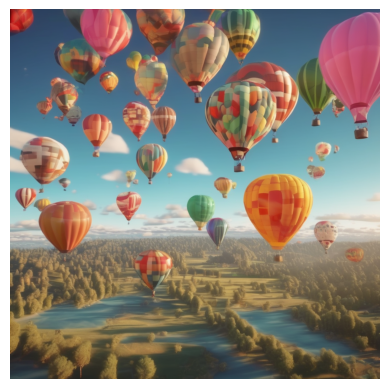

A portrait of an elderly man with deep wrinkles and wise eyes, set against a rustic background, 8K resolution, 
emotional depth.

  0%|          | 0/50 [00:00<?, ?it/s]

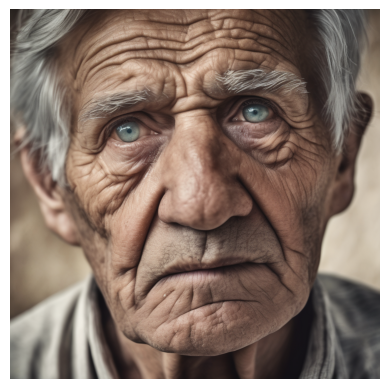

A futuristic robot interacting with children in a park, 4K resolution, friendly and engaging atmosphere.

  0%|          | 0/50 [00:00<?, ?it/s]

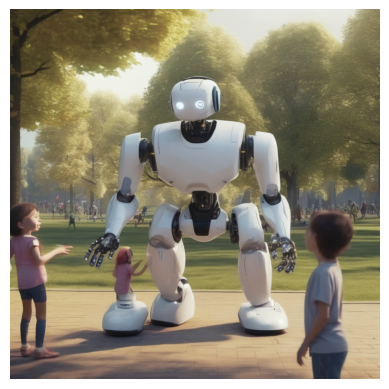

A beautiful sunset over a field of sunflowers, with golden light illuminating the flowers, 8K resolution, warm and 
inviting.

  0%|          | 0/50 [00:00<?, ?it/s]

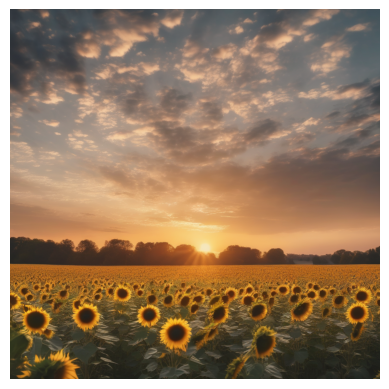

An intricate mandala pattern created with colorful sand, 16K resolution, showcasing artistry and precision.

  0%|          | 0/50 [00:00<?, ?it/s]

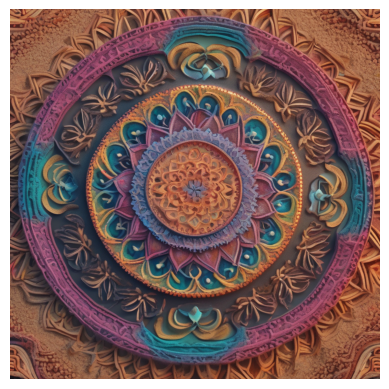

A tranquil zen garden with carefully raked sand and stones, 4K resolution, promoting peace and mindfulness.

  0%|          | 0/50 [00:00<?, ?it/s]

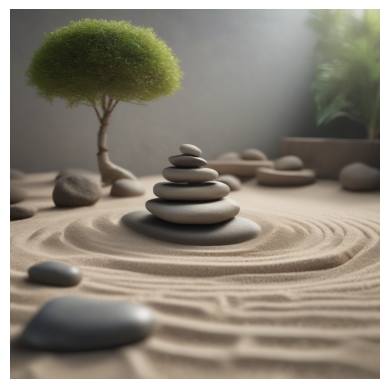

A dynamic sports scene capturing a soccer player in mid-air, 8K resolution, high energy and motion.

  0%|          | 0/50 [00:00<?, ?it/s]

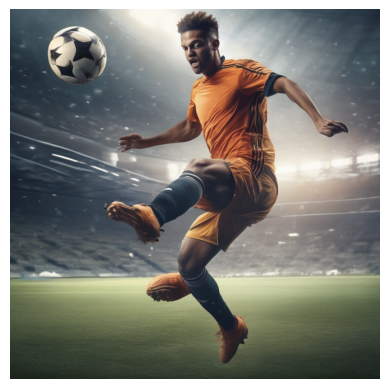

A stunning aurora borealis over a snowy landscape, 16K resolution, showcasing vibrant colors and natural beauty.

  0%|          | 0/50 [00:00<?, ?it/s]

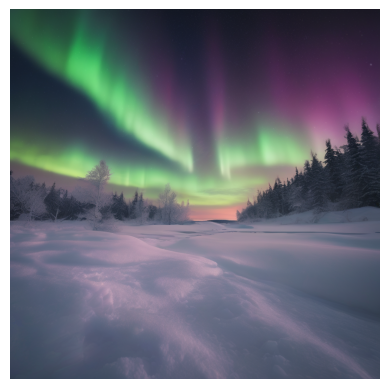

A detailed architectural rendering of a modern skyscraper, 4K resolution, showcasing innovative design.

  0%|          | 0/50 [00:00<?, ?it/s]

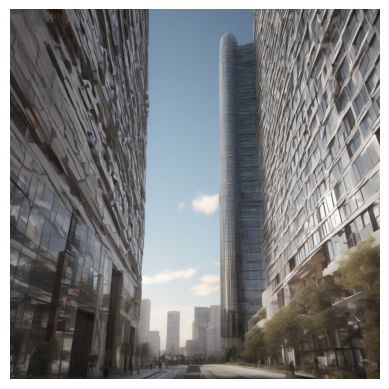

A fantasy scene of a knight battling a dragon in a fiery landscape, 8K resolution, epic and dramatic.

  0%|          | 0/50 [00:00<?, ?it/s]

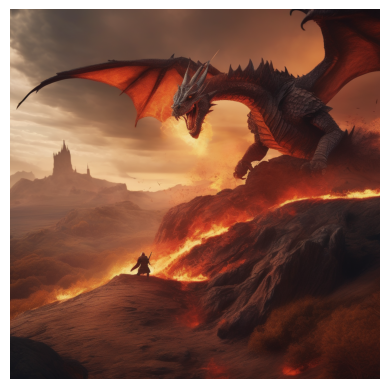

A charming village in autumn, with colorful leaves and cozy cottages, 4K resolution, warm and inviting.

  0%|          | 0/50 [00:00<?, ?it/s]

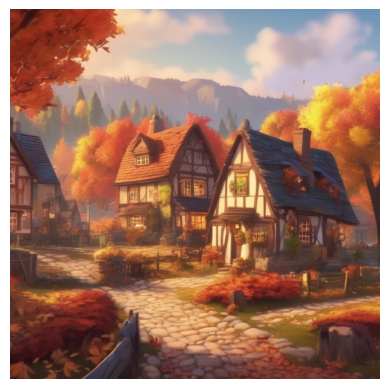

A close-up of a musician playing a violin, capturing emotion and passion, 8K resolution, artistic and expressive.

  0%|          | 0/50 [00:00<?, ?it/s]

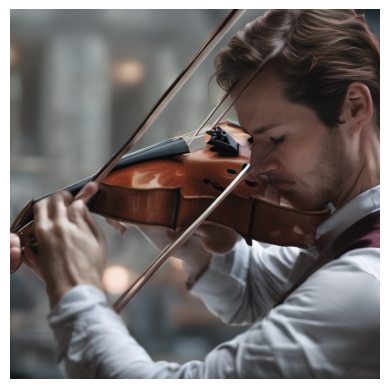

A futuristic city with flying cars and advanced technology, 16K resolution, imaginative and vibrant.

  0%|          | 0/50 [00:00<?, ?it/s]

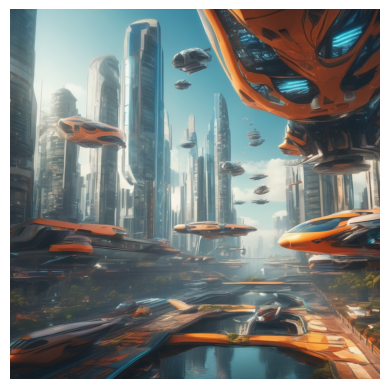

A serene lake surrounded by mountains, with a reflection of the sky, 4K resolution, peaceful and calming.

  0%|          | 0/50 [00:00<?, ?it/s]

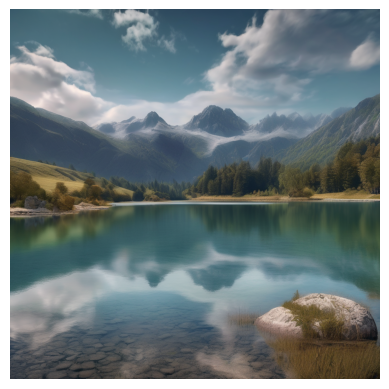

A magical forest with glowing plants and creatures, 8K resolution, enchanting and whimsical.

  0%|          | 0/50 [00:00<?, ?it/s]

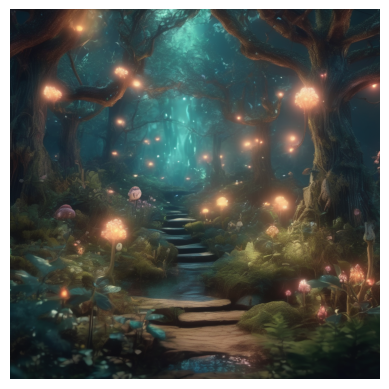

A detailed portrait of a lion with a majestic mane, 4K resolution, capturing strength and beauty.

  0%|          | 0/50 [00:00<?, ?it/s]

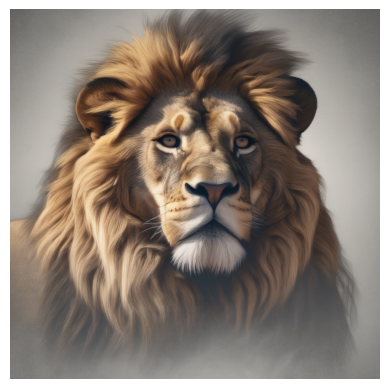

A vibrant carnival scene with rides, games, and happy families, 16K resolution, lively and colorful.

  0%|          | 0/50 [00:00<?, ?it/s]

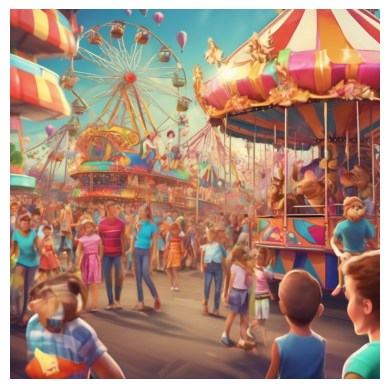

A cozy fireplace with stockings hanging for Christmas, warm lighting, 8K resolution, festive and inviting.

  0%|          | 0/50 [00:00<?, ?it/s]

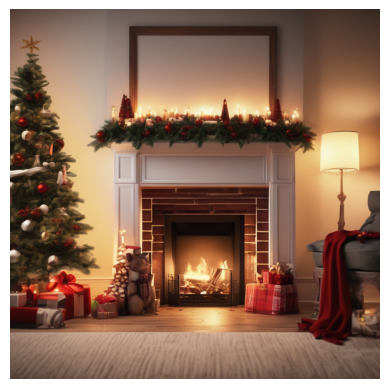

A beautiful woman in a flowing dress dancing in a field of flowers, 4K resolution, joyful and free-spirited.

  0%|          | 0/50 [00:00<?, ?it/s]

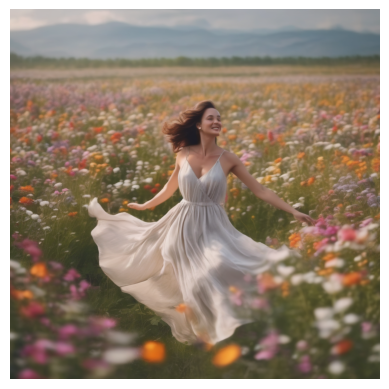

A detailed view of a city skyline at dusk, with lights beginning to twinkle, 8K resolution, urban beauty.

  0%|          | 0/50 [00:00<?, ?it/s]

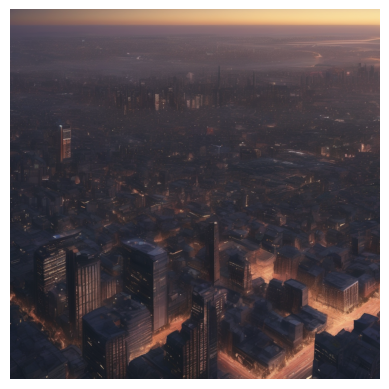

A whimsical garden with oversized flowers and friendly insects, 16K resolution, imaginative and playful.

  0%|          | 0/50 [00:00<?, ?it/s]

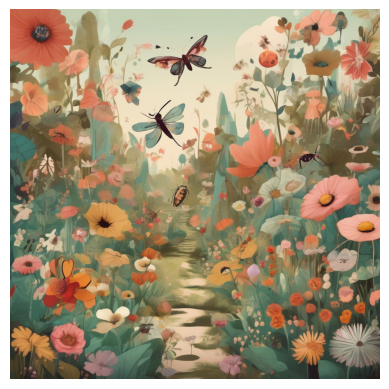

A close-up of a chef preparing a gourmet dish, showcasing culinary artistry, 4K resolution, vibrant and appetizing.

  0%|          | 0/50 [00:00<?, ?it/s]

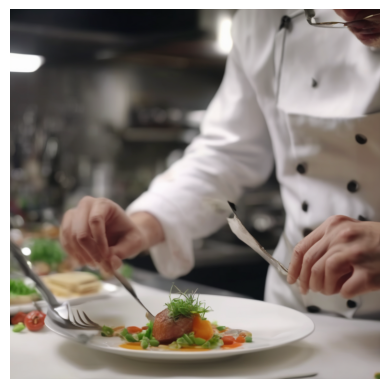

A tranquil snowy landscape with a single cabin, smoke rising from the chimney, 8K resolution, peaceful and serene.

  0%|          | 0/50 [00:00<?, ?it/s]

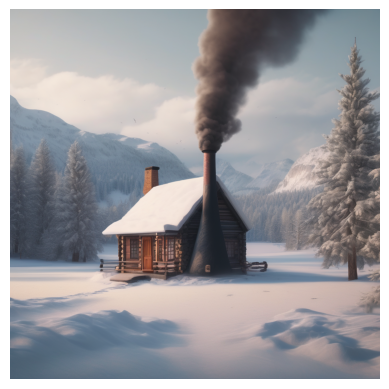

A dramatic lightning storm over a city, with dark clouds and flashes of light, 16K resolution, intense and 
powerful.

  0%|          | 0/50 [00:00<?, ?it/s]

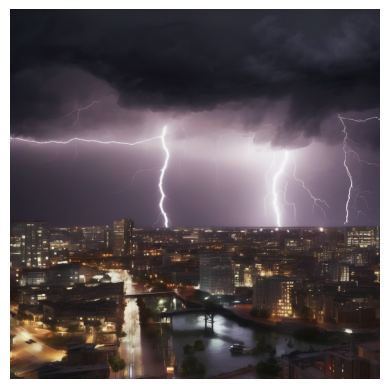

A beautiful sunset over a vineyard, with grapes ready for harvest, 4K resolution, rich and warm colors.

  0%|          | 0/50 [00:00<?, ?it/s]

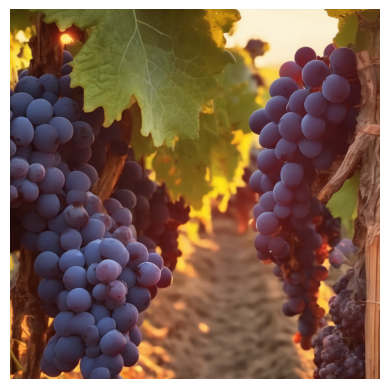

A fantasy castle in the clouds, surrounded by flying creatures, 8K resolution, magical and enchanting.

  0%|          | 0/50 [00:00<?, ?it/s]

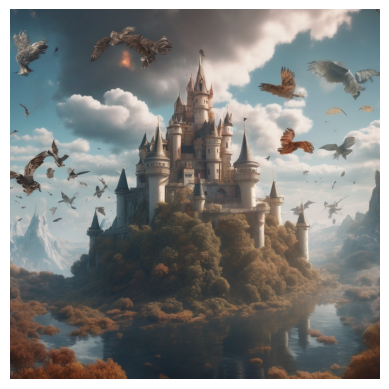

A close-up of a child's hand reaching for a butterfly, capturing innocence and wonder, 4K resolution, soft and 
delicate.

  0%|          | 0/50 [00:00<?, ?it/s]

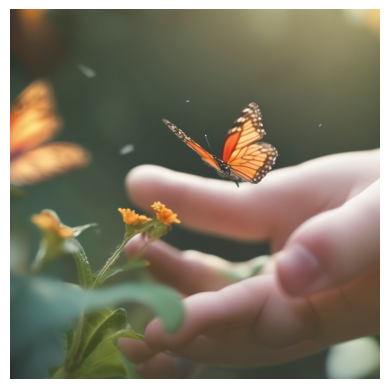

A vibrant underwater scene with a diver exploring a shipwreck, 16K resolution, adventurous and intriguing.

  0%|          | 0/50 [00:00<?, ?it/s]

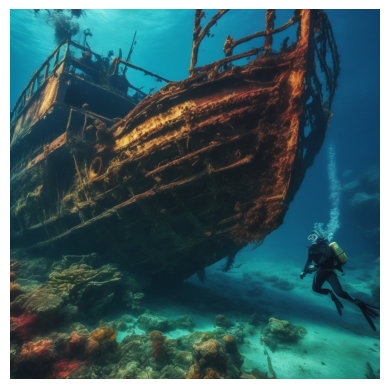

A detailed portrait of a wise owl perched on a branch, 8K resolution, showcasing its features and wisdom.

  0%|          | 0/50 [00:00<?, ?it/s]

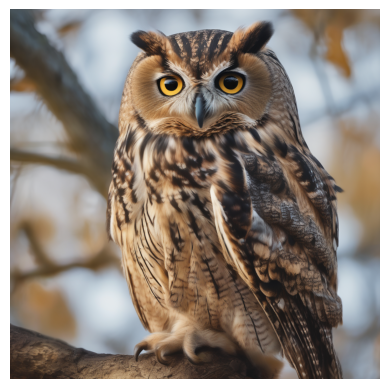

An idyllic countryside scene with rolling hills and a winding road, 4K resolution, peaceful and picturesque.

  0%|          | 0/50 [00:00<?, ?it/s]

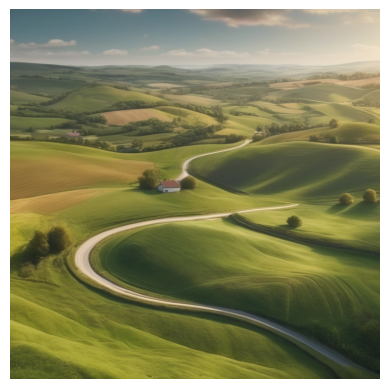

A dynamic street art mural showcasing cultural diversity, 8K resolution, colorful and engaging.

  0%|          | 0/50 [00:00<?, ?it/s]

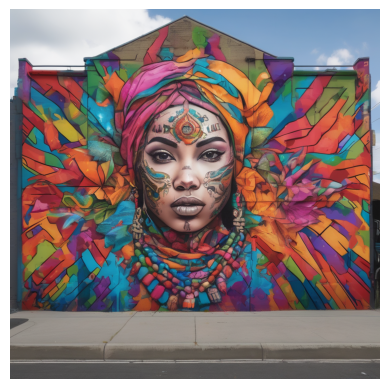

A fantasy landscape with a waterfall cascading into a crystal-clear pool, 16K resolution, serene and beautiful.

  0%|          | 0/50 [00:00<?, ?it/s]

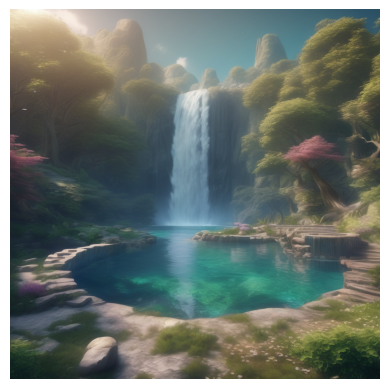

In [9]:
# Sample prompts array with 50 comprehensive prompts
prompts = [
    "A majestic mountain landscape at sunrise, with golden light illuminating the peaks, 8K resolution, ultra-detailed, photorealistic.",
    "A vibrant underwater scene featuring a coral reef teeming with colorful fish, 4K resolution, highly detailed, natural lighting.",
    "A futuristic city skyline at night, with neon lights reflecting on glass buildings, 16K resolution, cyberpunk style, high contrast.",
    "A serene Japanese garden in spring, cherry blossoms in full bloom, with a tranquil pond, 8K resolution, soft lighting, impressionistic style.",
    "A cozy cabin in the woods during winter, smoke rising from the chimney, snow-covered trees, 4K resolution, warm and inviting atmosphere.",
    "An astronaut floating in space, gazing at Earth from a distance, 8K resolution, realistic textures, deep space background.",
    "A whimsical fairy tale castle on a hill, surrounded by a magical forest, 16K resolution, vibrant colors, storybook illustration style.",
    "A close-up of a butterfly resting on a flower, showcasing intricate details and colors, 4K resolution, macro photography style.",
    "A bustling marketplace in an ancient city, with vendors selling colorful spices and textiles, 8K resolution, rich cultural details.",
    "A dramatic sunset over a calm ocean, with waves gently lapping at the shore, 4K resolution, vibrant colors, serene atmosphere.",
    "A fantasy landscape with floating islands and waterfalls, populated by mythical creatures, 16K resolution, highly imaginative.",
    "A portrait of a young woman with intricate tribal face paint, set against a colorful backdrop, 8K resolution, artistic style.",
    "A futuristic vehicle racing through a neon-lit city, with motion blur effects, 4K resolution, dynamic action scene.",
    "A detailed still life of fruits and flowers on a table, with soft natural lighting, 8K resolution, photorealistic style.",
    "A magical library filled with ancient books and glowing orbs, 16K resolution, enchanting atmosphere, fantasy art style.",
    "A serene beach at dawn, with gentle waves and seashells scattered on the sand, 4K resolution, peaceful and calming.",
    "A vibrant street festival with dancers and musicians, celebrating culture and diversity, 8K resolution, lively and colorful.",
    "An elegant peacock displaying its feathers in a lush garden, 4K resolution, showcasing vivid colors and intricate patterns.",
    "A dramatic mountain range reflected in a crystal-clear lake, 16K resolution, stunning natural beauty, high detail.",
    "A cozy coffee shop interior with people reading and chatting, warm lighting, 8K resolution, inviting atmosphere.",
    "A fantasy dragon perched on a cliff, overlooking a vast kingdom, 4K resolution, epic and majestic.",
    "A close-up of a vintage watch with intricate gears and details, 8K resolution, showcasing craftsmanship and elegance.",
    "A lush rainforest with exotic plants and animals, sunlight filtering through the canopy, 16K resolution, vibrant colors.",
    "A whimsical hot air balloon festival in the sky, with colorful balloons floating above a picturesque landscape, 4K resolution.",
    "A portrait of an elderly man with deep wrinkles and wise eyes, set against a rustic background, 8K resolution, emotional depth.",
    "A futuristic robot interacting with children in a park, 4K resolution, friendly and engaging atmosphere.",
    "A beautiful sunset over a field of sunflowers, with golden light illuminating the flowers, 8K resolution, warm and inviting.",
    "An intricate mandala pattern created with colorful sand, 16K resolution, showcasing artistry and precision.",
    "A tranquil zen garden with carefully raked sand and stones, 4K resolution, promoting peace and mindfulness.",
    "A dynamic sports scene capturing a soccer player in mid-air, 8K resolution, high energy and motion.",
    "A stunning aurora borealis over a snowy landscape, 16K resolution, showcasing vibrant colors and natural beauty.",
    "A detailed architectural rendering of a modern skyscraper, 4K resolution, showcasing innovative design.",
    "A fantasy scene of a knight battling a dragon in a fiery landscape, 8K resolution, epic and dramatic.",
    "A charming village in autumn, with colorful leaves and cozy cottages, 4K resolution, warm and inviting.",
    "A close-up of a musician playing a violin, capturing emotion and passion, 8K resolution, artistic and expressive.",
    "A futuristic city with flying cars and advanced technology, 16K resolution, imaginative and vibrant.",
    "A serene lake surrounded by mountains, with a reflection of the sky, 4K resolution, peaceful and calming.",
    "A magical forest with glowing plants and creatures, 8K resolution, enchanting and whimsical.",
    "A detailed portrait of a lion with a majestic mane, 4K resolution, capturing strength and beauty.",
    "A vibrant carnival scene with rides, games, and happy families, 16K resolution, lively and colorful.",
    "A cozy fireplace with stockings hanging for Christmas, warm lighting, 8K resolution, festive and inviting.",
    "A beautiful woman in a flowing dress dancing in a field of flowers, 4K resolution, joyful and free-spirited.",
    "A detailed view of a city skyline at dusk, with lights beginning to twinkle, 8K resolution, urban beauty.",
    "A whimsical garden with oversized flowers and friendly insects, 16K resolution, imaginative and playful.",
    "A close-up of a chef preparing a gourmet dish, showcasing culinary artistry, 4K resolution, vibrant and appetizing.",
    "A tranquil snowy landscape with a single cabin, smoke rising from the chimney, 8K resolution, peaceful and serene.",
    "A dramatic lightning storm over a city, with dark clouds and flashes of light, 16K resolution, intense and powerful.",
    "A beautiful sunset over a vineyard, with grapes ready for harvest, 4K resolution, rich and warm colors.",
    "A fantasy castle in the clouds, surrounded by flying creatures, 8K resolution, magical and enchanting.",
    "A close-up of a child's hand reaching for a butterfly, capturing innocence and wonder, 4K resolution, soft and delicate.",
    "A vibrant underwater scene with a diver exploring a shipwreck, 16K resolution, adventurous and intriguing.",
    "A detailed portrait of a wise owl perched on a branch, 8K resolution, showcasing its features and wisdom.",
    "An idyllic countryside scene with rolling hills and a winding road, 4K resolution, peaceful and picturesque.",
    "A dynamic street art mural showcasing cultural diversity, 8K resolution, colorful and engaging.",
    "A fantasy landscape with a waterfall cascading into a crystal-clear pool, 16K resolution, serene and beautiful."
]


# Iteration loop to display one prompt at a time
for prompt in prompts:
    # Randomly select a style from the styles list
    random_style = random.choice(styles)
    
    # Create highlighted text for the prompt with the random style
    highlighted_prompt = Text(prompt, style=random_style)
    
    # Print the highlighted prompt
    console.print(highlighted_prompt)
    
    # Generate the image
    img = generate_stable_diffusion_image(prompt)
    
    # Display the image if generated
    if img is not None:
        plt.imshow(img)
        plt.axis('off')  # Hide axes
        plt.show()
    
    time.sleep(2)  # Wait for 2 seconds before showing the next image